<a href="https://colab.research.google.com/github/gnganesh99/DKL_on_STM/blob/main/Workflow_DKL_STM.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>


# Workflow model for the Deep Kernel Learning implemented on STM.

Refs:

1. Narasimha, Ganesh, et al. "Multiscale structure-property discovery via active learning in scanning tunneling microscopy." arXiv preprint arXiv:2404.07074 (2024).

2. Wilson, Andrew Gordon, et al. "Deep kernel learning." Artificial intelligence and statistics. PMLR, 2016.

3. https://github.com/gnganesh99/DKL_on_STM

# Install and Import packages

In [ ]:
! pip install gpax
! pip install atomai
!pip install sidpy

Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/pip/_internal/cli/base_command.py", line 169, in exc_logging_wrapper
    status = run_func(*args)
  File "/usr/local/lib/python3.10/dist-packages/pip/_internal/cli/req_command.py", line 242, in wrapper
    return func(self, options, args)
  File "/usr/local/lib/python3.10/dist-packages/pip/_internal/commands/install.py", line 377, in run
    requirement_set = resolver.resolve(
  File "/usr/local/lib/python3.10/dist-packages/pip/_internal/resolution/resolvelib/resolver.py", line 92, in resolve
    result = self._result = resolver.resolve(
  File "/usr/local/lib/python3.10/dist-packages/pip/_vendor/resolvelib/resolvers.py", line 546, in resolve
    state = resolution.resolve(requirements, max_rounds=max_rounds)
  File "/usr/local/lib/python3.10/dist-packages/pip/_vendor/resolvelib/resolvers.py", line 443, in resolve
    newly_unsatisfied_names = {
  File "/usr/local/lib/python3.10/dist-packages/pip/_vendor

In [ ]:
from warnings import filterwarnings

import numpy as np
import matplotlib.pyplot as plt
import math
import pandas as pd
import os

from scipy.signal import find_peaks
from sklearn.model_selection import train_test_split

import gpax
from atomai.utils import get_coord_grid, extract_patches_and_spectra, extract_patches, extract_subimages
import atomai as aoi
import gdown

import cv2
import random



import os
import numpy as np
import h5py
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable
import sidpy


gpax.utils.enable_x64()

# Functions

In [264]:
def plot_DKL_prediction(obj_mean, obj_var, obj, indices_test, indices_m, y_measured):
    '''
    Plots the objective-mean, variance and the acquisiion function across the sample region
    '''

    fig, ax = plt.subplots(nrows = 1, ncols = 3, figsize = (15,5))

    fig.tight_layout(pad = 7)
    next_coord = indices_test[obj.argmax()]
    indices = indices_all
    a = ax[0].scatter(indices[:,1], indices[:,0], c=obj_mean, cmap='viridis', linewidth=5)
    ax[0].scatter(indices_m[:,1], indices_m[:,0], marker='s', c=y_measured, cmap='jet', linewidth=0.2)
    ax[0].scatter(next_coord[1], next_coord[0], marker='x', c='r')
    #ax[0].scatter(X_opt_GP[0, 0], X_opt_GP[0, 1], marker='o', c='r')
    divider = make_axes_locatable(ax[0])
    cax = divider.append_axes('right', size='5%', pad=0.05)
    fig.colorbar(a, cax=cax, orientation='vertical')
    ax[0].set_title('Objective mean map', fontsize=10, pad = 14)

    ax[0].set_xlabel('X')
    ax[0].set_ylabel('Y')
    #ax[0].axes.xaxis.set_visible(False)
    #ax[0].axes.yaxis.set_visible(False)
    #ax[0].colorbar(a)

    b = ax[1].scatter(indices[:,1], indices[:,0], c=obj_var, cmap='viridis', linewidth=5)
    divider = make_axes_locatable(ax[1])
    cax = divider.append_axes('right', size='5%', pad=0.05)
    fig.colorbar(b, cax=cax, orientation='vertical')
    ax[1].set_title('Objective variance map', fontsize=10, pad = 14)
    ax[1].set_xlabel('X')
    ax[1].set_ylabel('Y')
    #ax[1].axes.xaxis.set_visible(False)
    #ax[1].axes.yaxis.set_visible(False)
    #ax[1].colorbar(b)


    c= ax[2].scatter(indices_test[:, 1], indices_test[:, 0], c=obj, s = 50)
    ax[2].scatter(next_coord[1], next_coord[0], marker='x', c='k')
    ax[2].set_title("Acquisition function values")
    #divider = make_axes_locatable(ax[2])
    #cax = divider.append_axes('right', size='5%', pad=0.05)

    plt.show()

def normalize_0to1(array):
    '''
    Returns the normalized array in range 0-1
    '''

    array = np.asarray(array)
    norm_array = (array -  np.min(array))/(np.max(array) - np.min(array))
    return norm_array

def positive_current_area(v, i):

    '''
    Returns the integrated current (or didv) for positive bias sweep, V > 0
    '''
    v_s = []
    curr_s = []
    scalar = 0

    for k in range(len(v)):
        if v[k] > 0:
            v_s.append(v[k])
            curr_s.append(i[k])

    scalar += np.trapz(curr_s, x = v_s)

    return scalar

# Import ground truth data

In [ ]:
# Download ground truth data
!gdown https://drive.google.com/uc?id=15HaspgtaEY47HGbqE6fJrSazCsuGkt9L


Downloading...
From: https://drive.google.com/uc?id=15HaspgtaEY47HGbqE6fJrSazCsuGkt9L
To: /content/cits_metadata_largearea
100% 33.5M/33.5M [00:00<00:00, 40.2MB/s]


Measurements conditions

In [210]:
# Sample region is 250 nm x 250 nm; grid points = 180 x 180

x_range = np.linspace(0, 2.5E-7, 180)

#Bias sweep in range : -1.5 to 2.5 V, 121 sweep point
V_range = np.linspace(-1.5, 2.5, 121)

In [211]:
file_name = r"/content/cits_metadata_largearea"
hf = h5py.File(file_name, 'r+')
sidpy.hdf_utils.print_tree(hf)

/
├ Measurement_000
  ---------------
  ├ Current_spectroscopy
    --------------------
    ├ Current_spectroscopy
      --------------------
      ├ Current_spectroscopy
      ├ a
      ├ b
      ├ c
├ Measurement_001
  ---------------
  ├ STM Image
    ---------
    ├ Image
      -----
      ├ Image
      ├ a
      ├ b


## Image data

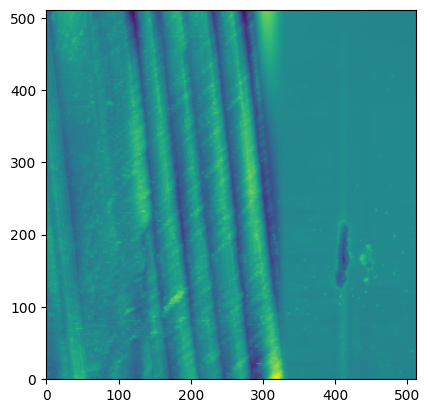

In [213]:
ds_image = hf["Measurement_001/STM Image/Image/Image"]

#Normalize the morphology image in range 0-1
ds_image =  normalize_0to1(ds_image)

plt.imshow(ds_image, origin='lower')

## CITS ground truth data

In [215]:
dataset = hf["Measurement_000/Current_spectroscopy/Current_spectroscopy/Current_spectroscopy"]
dataset = np.asarray(dataset)

print('contains current-volatge spectrotroscopy dataset of size:',dataset.shape)

contains current-volatge spectrotroscopy dataset of size: (180, 180, 121)


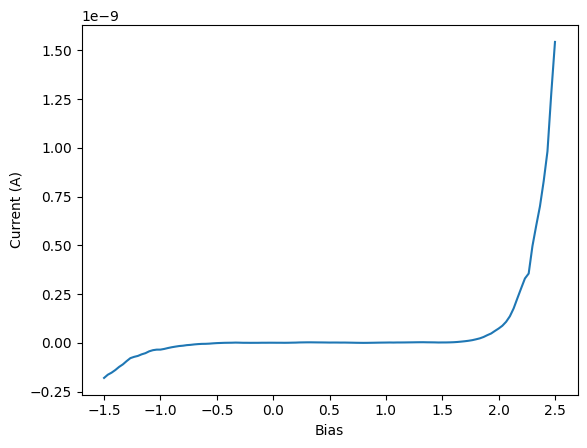

In [219]:
point_index = [10, 10]

#current spectroscopy at point_index:
i = dataset[point_index[0], point_index[1]]

plt.plot(V_range, i)
plt.xlabel('Bias (V)')
plt.ylabel('Current (A)')
plt.show()

## Scalarizer

Here we introduce the scalarizer as the integration of the I-V spectrum for V>0.
This is given by the function "positive_current_area"

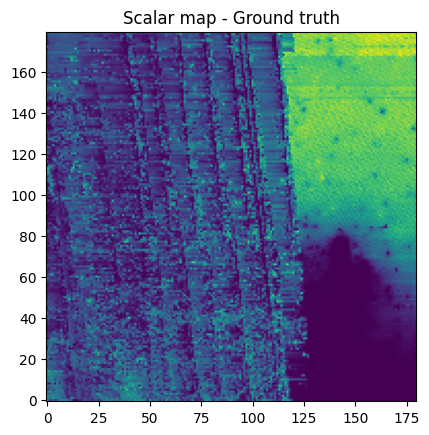

In [221]:
#scalarized dataset
scalar_ds = np.zeros([dataset.shape[0], dataset.shape[1]])

for i in range(dataset.shape[0]):
  for j in range(dataset.shape[1]):

    current_spectrum  = dataset[i, j, :]
    scalar = positive_current_area(V_range, current_spectrum)
    scalar_ds[i, j] = scalar

plt.imshow(scalar_ds, origin = 'lower')
plt.title("Scalar map - Ground truth")
plt.show()


In [222]:
hf.close()

# Images for training

features shape =  (2304, 30, 30)
Patch coordinates =  (2304, 2)
Image is fragmented to multiple pathches.
Coordinate at grid index 0 = [20. 20.]
Patch at index 0:



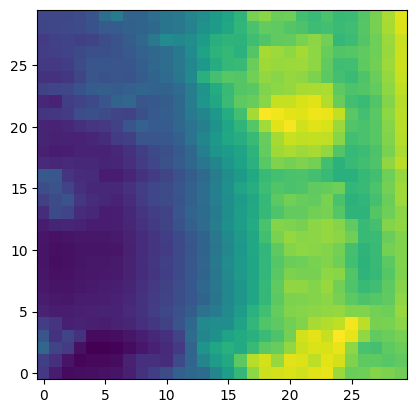

In [245]:
# Window_size is the width (in pixels) of the patch considered as a feature-example for training
window_size = 30

# Coordinate step is the distance between the center of two adjacent image patches
coordinate_step = 10


coords = get_coord_grid(ds_image, step = coordinate_step, return_dict= False)
indices_all = coords
#print('initial coordinates = ',coords[:, 0].shape)


# Extract patches (or features) and the center coordinates of each patch.
extracted_features = extract_subimages(ds_image, coordinates = coords, window_size = window_size)
patches, coordinates, _ = extracted_features
patches = patches.squeeze()



print('features shape = ',patches.shape)
print('Patch coordinates = ',coordinates.shape)

grid_index = 0
print(f"Image is fragmented to multiple pathches.\nCoordinate at grid index {grid_index} = {coordinates[grid_index]}\nPatch at index {grid_index}:\n")

plt.imshow(patches[grid_index], origin = 'lower')
plt.show()

Prepare train and test sets

In [248]:
# Reshape patches into 1D vectors
n, d1, d2 = patches.shape
X = patches.reshape(n, d1*d2)

# Reshape ground-truth scalars for one-to-one correlation with the image patches
scalar_dim = int(n**0.5)
data_spec = cv2.resize(scalar_ds,(scalar_dim, scalar_dim))

y = np.reshape(data_spec, (n))
indices_all = coordinates
X.shape, y.shape


((2304, 900), (2304,))

In [279]:
# Normalizing each of the image patches for better training on image features

X_norm = []
for patch_i in X:
  norm_patch = normalize_0to1(patch_i)
  X_norm.append(norm_patch)

X = np.asarray(X_norm)
X.shape

(2304, 900)

# DKL Implementation - Active learning

Create X_train and y_train which are our measured image patches (from STM topography) and scalars derived from tunneling spectroscopy, respectively.
The indices_train are grid coordinates of the measured points

X_test and y_test are the "unkwown" ones.
The indices_test are the grid coordinates of the remaining available points on the grid

In [280]:
# Test train split
train_size = 0.1       # 0.1 implies 10 % of data for model training

(X_train, X_test, y_train, y_test, indices_train, indices_test) =  train_test_split(X, y, indices_all, train_size = train_size, shuffle=True, random_state=3)

In [274]:
y_train.shape

(230,)

Plot train set

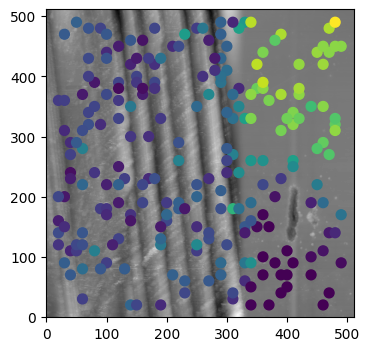

In [281]:
plt.figure(figsize=(4, 4))
plt.imshow(ds_image, origin ='lower', cmap = 'gray')
plt.scatter(indices_train[:, 1], indices_train[:, 0], s=50, c=y_train)
initial_train = len(y_train)

## Active learning based exploration

1/100


100%|██████████| 100/100 [00:03<00:00, 26.75it/s, init loss: 60356.3772, avg. loss [96-100]: 56991.2376]



Inferred GP kernel parameters
k_length         [4.0812 3.5728]
k_scale          0.1432
noise            0.06380000000000001


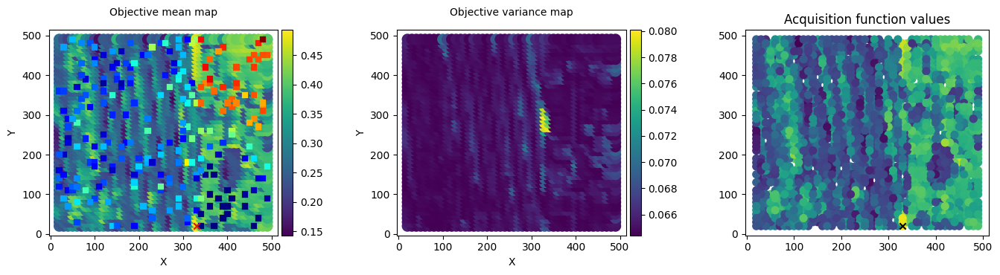

2/100


100%|██████████| 100/100 [00:04<00:00, 21.61it/s, init loss: 60357.6272, avg. loss [96-100]: 57007.6187]



Inferred GP kernel parameters
k_length         [5.4472 4.1443]
k_scale          0.1221
noise            0.0611


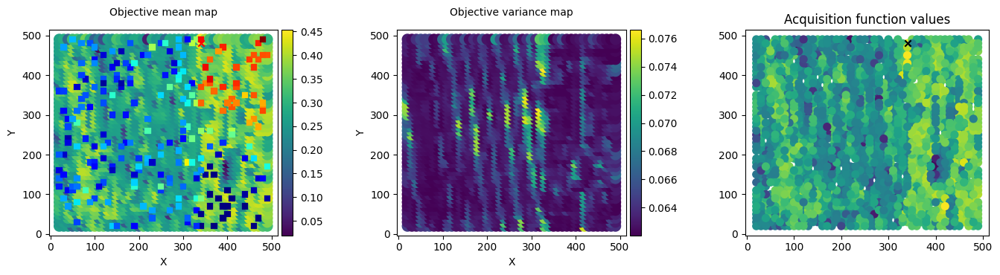

3/100


100%|██████████| 100/100 [00:03<00:00, 27.15it/s, init loss: 60358.8676, avg. loss [96-100]: 57001.0399]



Inferred GP kernel parameters
k_length         [3.8281 4.3645]
k_scale          0.13290000000000002
noise            0.06380000000000001


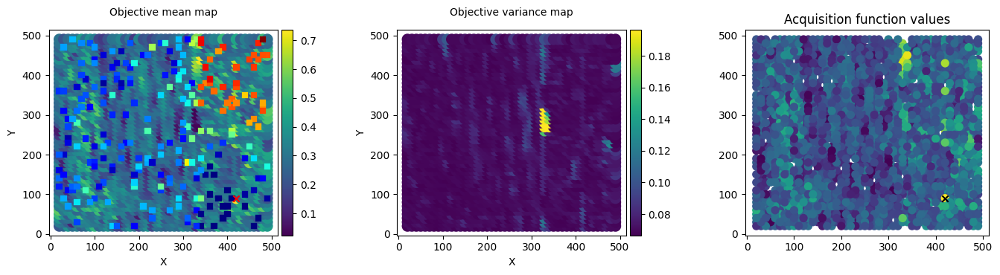

4/100


100%|██████████| 100/100 [00:04<00:00, 20.08it/s, init loss: 60360.0535, avg. loss [96-100]: 56987.6315]



Inferred GP kernel parameters
k_length         [2.8557 2.8249]
k_scale          0.1661
noise            0.06570000000000001


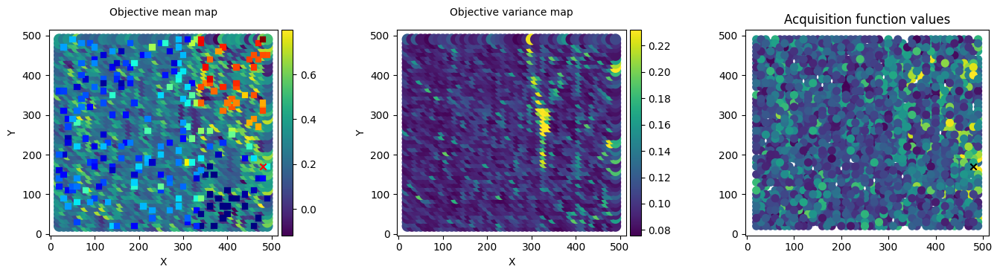

5/100


100%|██████████| 100/100 [00:05<00:00, 18.84it/s, init loss: 60361.1415, avg. loss [96-100]: 56991.6080]



Inferred GP kernel parameters
k_length         [3.2903 3.5271]
k_scale          0.1531
noise            0.06520000000000001


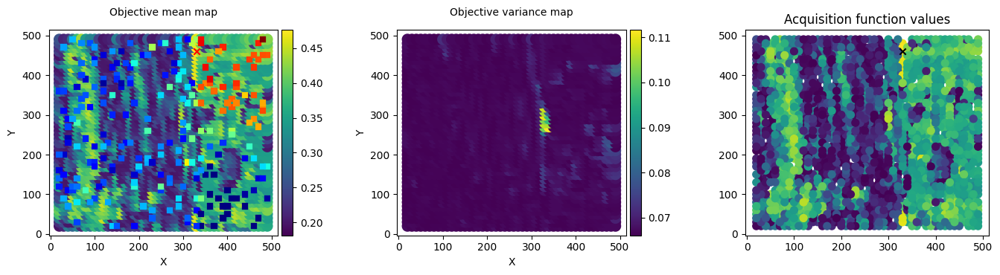

6/100


100%|██████████| 100/100 [00:05<00:00, 18.14it/s, init loss: 60362.4056, avg. loss [96-100]: 57036.2652]



Inferred GP kernel parameters
k_length         [3.2481 3.7176]
k_scale          0.1532
noise            0.06470000000000001


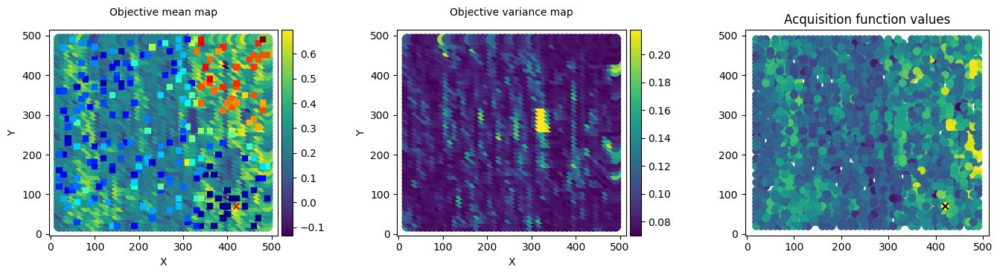

7/100


100%|██████████| 100/100 [00:04<00:00, 22.77it/s, init loss: 60363.6499, avg. loss [96-100]: 56991.0788]



Inferred GP kernel parameters
k_length         [2.7169 3.4845]
k_scale          0.15860000000000002
noise            0.06570000000000001


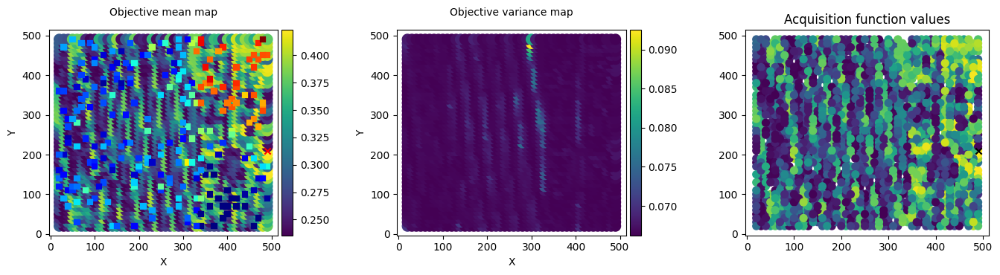

8/100


100%|██████████| 100/100 [00:04<00:00, 21.65it/s, init loss: 60364.7905, avg. loss [96-100]: 57011.8503]



Inferred GP kernel parameters
k_length         [3.6082 3.4776]
k_scale          0.167
noise            0.0653


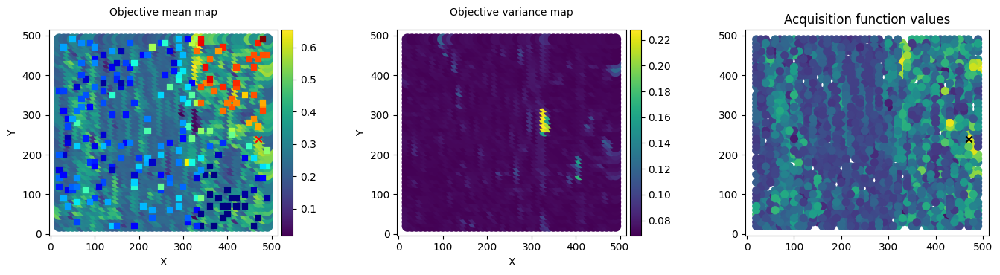

9/100


100%|██████████| 100/100 [00:04<00:00, 22.01it/s, init loss: 60365.9050, avg. loss [96-100]: 56987.5082]



Inferred GP kernel parameters
k_length         [3.6899 4.2649]
k_scale          0.1506
noise            0.066


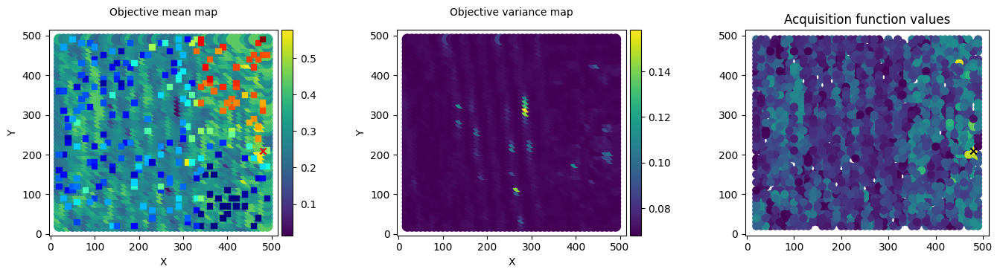

10/100


100%|██████████| 100/100 [00:04<00:00, 23.43it/s, init loss: 60367.0612, avg. loss [96-100]: 56996.2599]



Inferred GP kernel parameters
k_length         [3.0833 3.4634]
k_scale          0.1688
noise            0.065


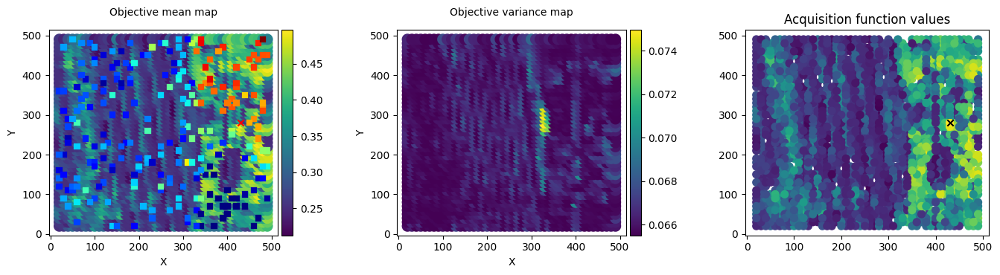

11/100


100%|██████████| 100/100 [00:04<00:00, 20.82it/s, init loss: 60368.2069, avg. loss [96-100]: 57018.3551]



Inferred GP kernel parameters
k_length         [4.5434 4.4925]
k_scale          0.1221
noise            0.0655


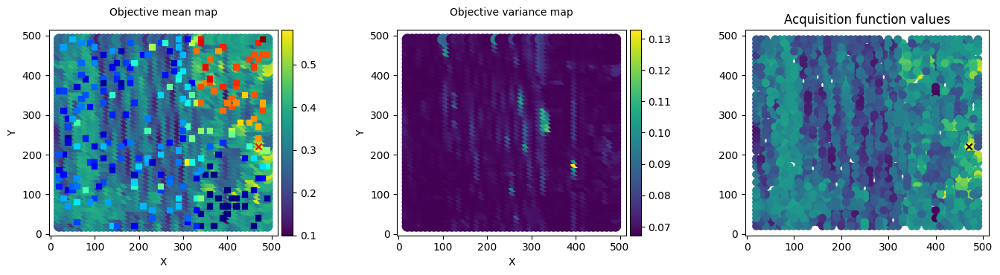

12/100


100%|██████████| 100/100 [00:04<00:00, 20.35it/s, init loss: 60369.3989, avg. loss [96-100]: 56998.5406]



Inferred GP kernel parameters
k_length         [5.4117 3.9356]
k_scale          0.1361
noise            0.0635


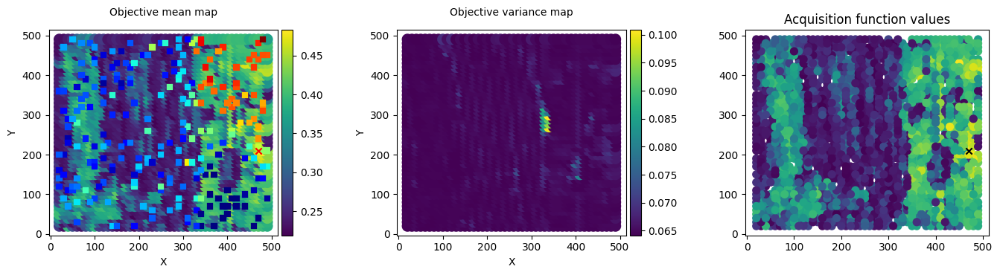

13/100


100%|██████████| 100/100 [00:04<00:00, 20.51it/s, init loss: 60370.5185, avg. loss [96-100]: 56999.4319]



Inferred GP kernel parameters
k_length         [4.3689 3.7177]
k_scale          0.1562
noise            0.0655


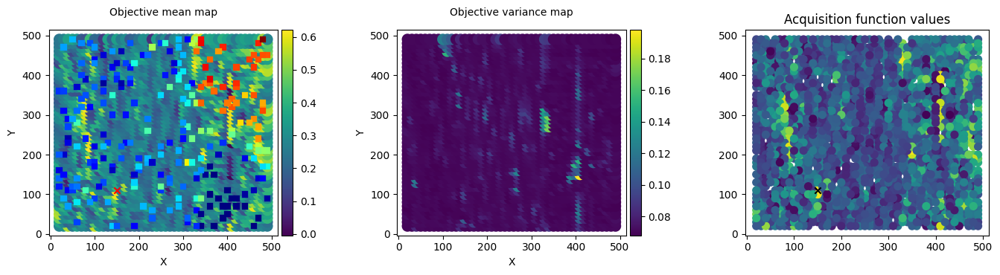

14/100


100%|██████████| 100/100 [00:05<00:00, 18.18it/s, init loss: 60371.6479, avg. loss [96-100]: 57022.9869]



Inferred GP kernel parameters
k_length         [4.2926 4.569 ]
k_scale          0.1351
noise            0.0621


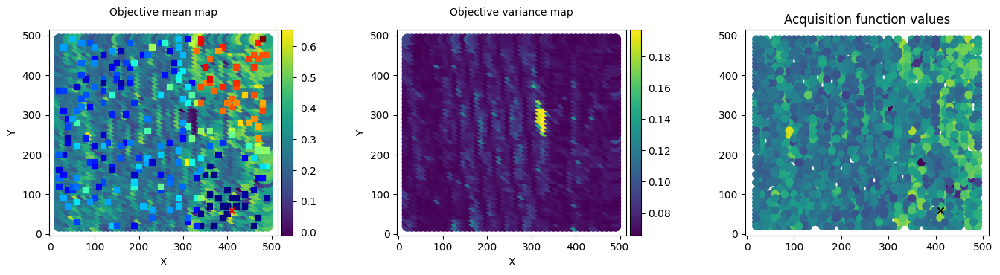

15/100


100%|██████████| 100/100 [00:04<00:00, 20.16it/s, init loss: 60372.8343, avg. loss [96-100]: 57002.8785]



Inferred GP kernel parameters
k_length         [3.5934 3.0168]
k_scale          0.17270000000000002
noise            0.065


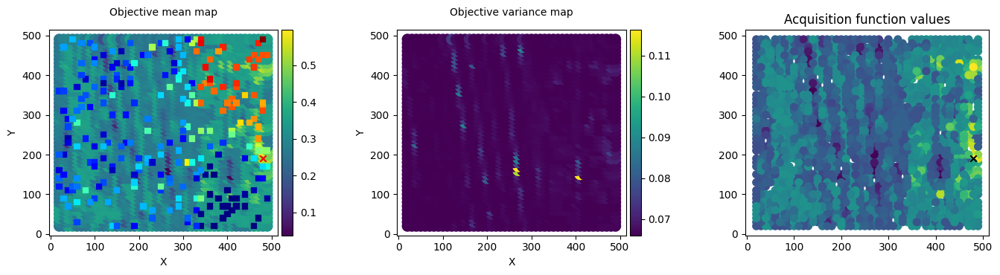

16/100


100%|██████████| 100/100 [00:04<00:00, 20.35it/s, init loss: 60374.0166, avg. loss [96-100]: 57009.8566]



Inferred GP kernel parameters
k_length         [3.8069 4.0887]
k_scale          0.13970000000000002
noise            0.0625


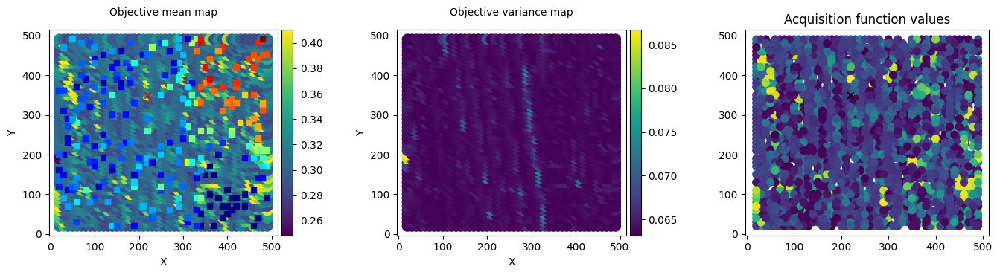

17/100


100%|██████████| 100/100 [00:05<00:00, 17.95it/s, init loss: 60375.2611, avg. loss [96-100]: 56987.5647]



Inferred GP kernel parameters
k_length         [3.1163 2.8736]
k_scale          0.17
noise            0.0653


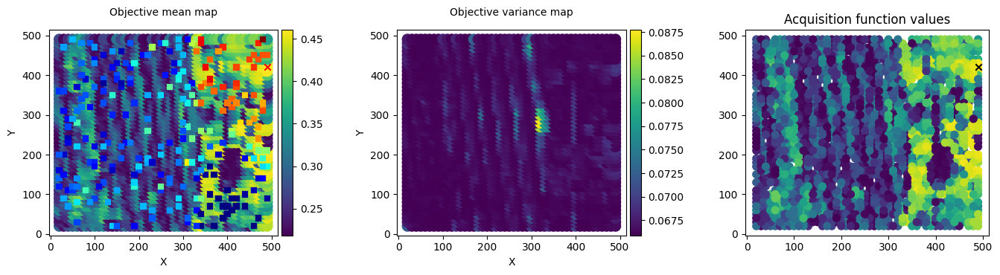

18/100


100%|██████████| 100/100 [00:05<00:00, 17.20it/s, init loss: 60376.5492, avg. loss [96-100]: 56995.5941]



Inferred GP kernel parameters
k_length         [4.0286 4.0471]
k_scale          0.1375
noise            0.0634


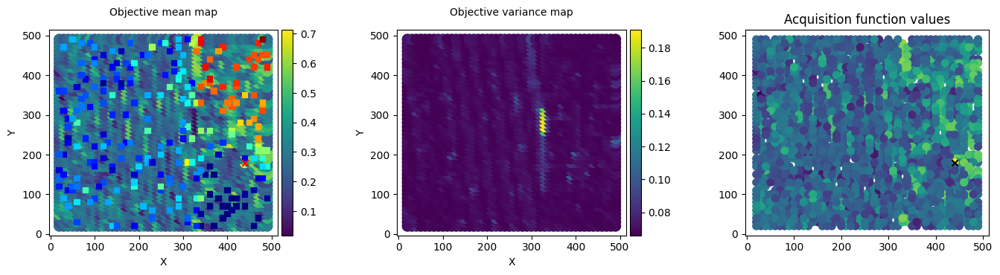

19/100


100%|██████████| 100/100 [00:05<00:00, 17.51it/s, init loss: 60377.7613, avg. loss [96-100]: 56984.1995]



Inferred GP kernel parameters
k_length         [5.6344 3.4783]
k_scale          0.1431
noise            0.0651


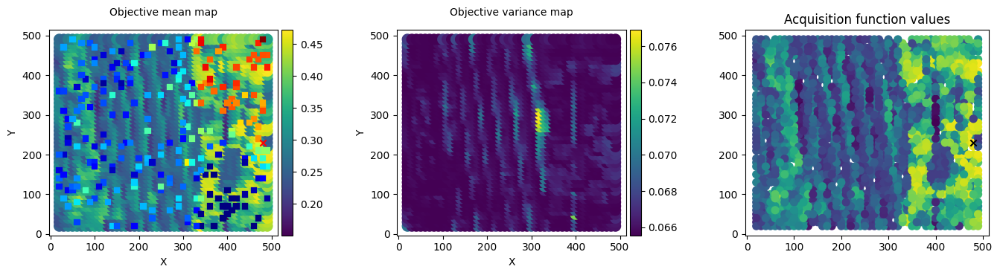

20/100


100%|██████████| 100/100 [00:05<00:00, 16.85it/s, init loss: 60378.9259, avg. loss [96-100]: 56993.6493]



Inferred GP kernel parameters
k_length         [4.8336 4.0663]
k_scale          0.1424
noise            0.0637


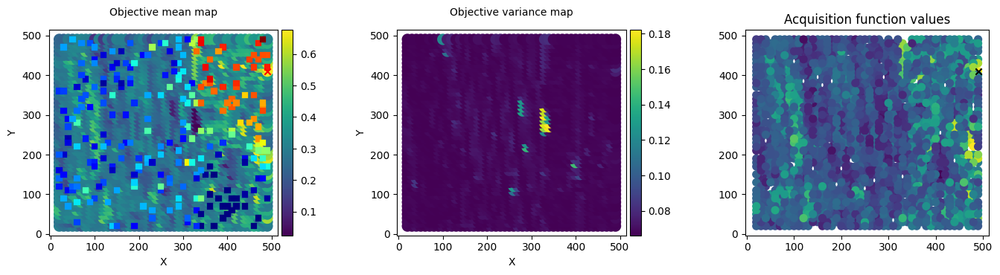

21/100


100%|██████████| 100/100 [00:05<00:00, 16.91it/s, init loss: 60380.1128, avg. loss [96-100]: 57024.6908]



Inferred GP kernel parameters
k_length         [3.8239 4.0939]
k_scale          0.1578
noise            0.0637


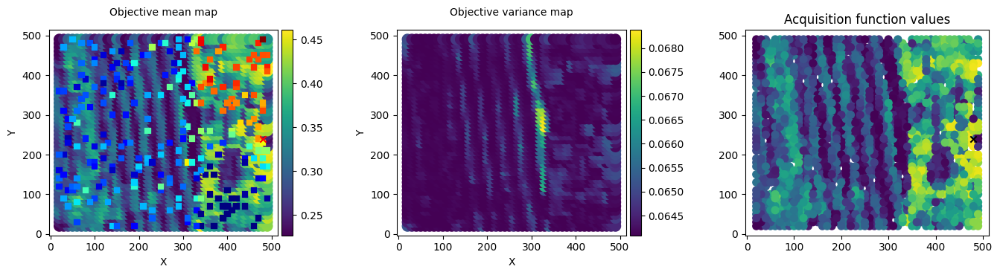

22/100


100%|██████████| 100/100 [00:05<00:00, 17.81it/s, init loss: 60381.3097, avg. loss [96-100]: 57036.7988]



Inferred GP kernel parameters
k_length         [4.439  4.8672]
k_scale          0.1287
noise            0.0634


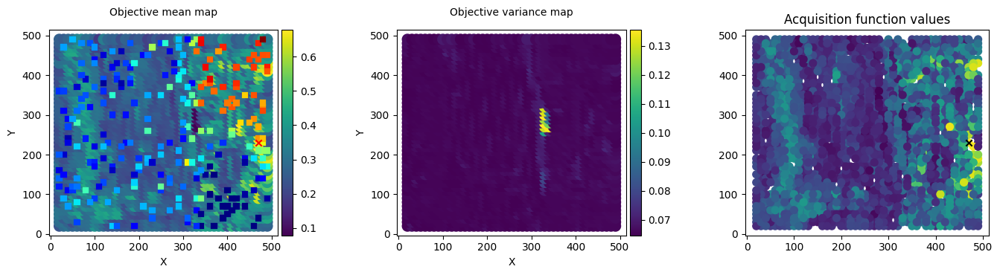

23/100


100%|██████████| 100/100 [00:05<00:00, 17.58it/s, init loss: 60382.5014, avg. loss [96-100]: 56997.0080]



Inferred GP kernel parameters
k_length         [3.7512 3.9608]
k_scale          0.1356
noise            0.0626


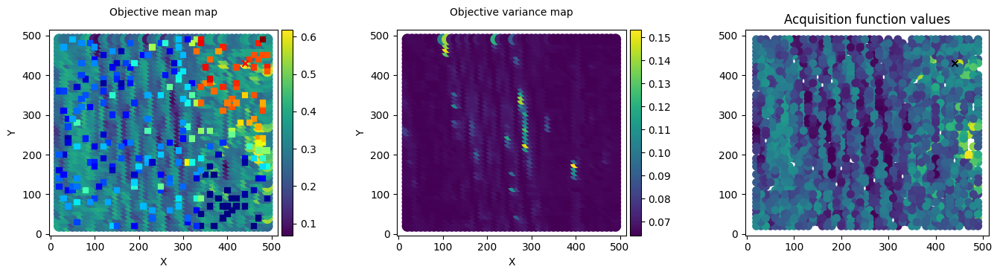

24/100


100%|██████████| 100/100 [00:06<00:00, 15.85it/s, init loss: 60383.7804, avg. loss [96-100]: 57014.2949]



Inferred GP kernel parameters
k_length         [4.8277 3.7925]
k_scale          0.1332
noise            0.0616


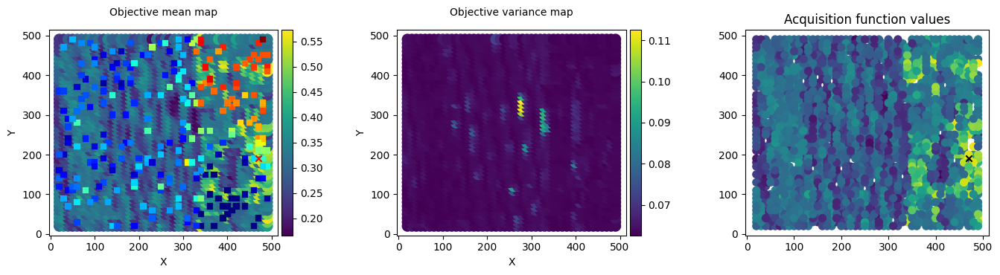

25/100


100%|██████████| 100/100 [00:06<00:00, 15.79it/s, init loss: 60384.9302, avg. loss [96-100]: 56999.5677]



Inferred GP kernel parameters
k_length         [5.0017 4.451 ]
k_scale          0.1383
noise            0.06430000000000001


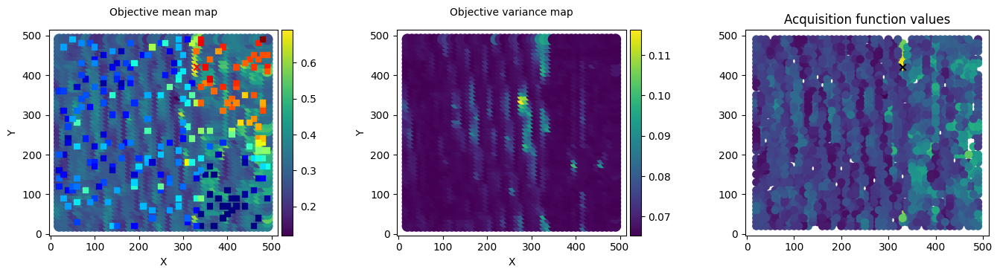

26/100


100%|██████████| 100/100 [00:06<00:00, 15.74it/s, init loss: 60386.1106, avg. loss [96-100]: 57022.3268]



Inferred GP kernel parameters
k_length         [5.0719 4.9664]
k_scale          0.1277
noise            0.0613


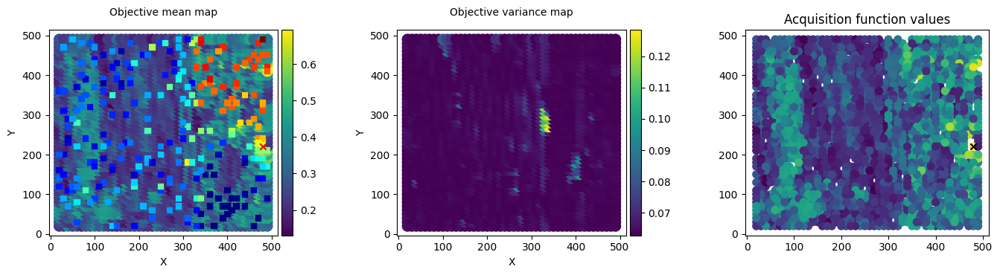

27/100


100%|██████████| 100/100 [00:06<00:00, 14.81it/s, init loss: 60387.2235, avg. loss [96-100]: 57016.5585]



Inferred GP kernel parameters
k_length         [4.6013 5.2682]
k_scale          0.1283
noise            0.0627


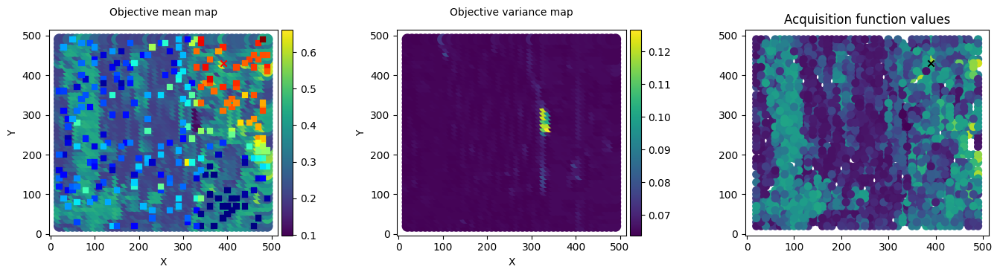

28/100


100%|██████████| 100/100 [00:06<00:00, 16.62it/s, init loss: 60388.4727, avg. loss [96-100]: 57006.5247]



Inferred GP kernel parameters
k_length         [4.7234 6.3405]
k_scale          0.13040000000000002
noise            0.060700000000000004


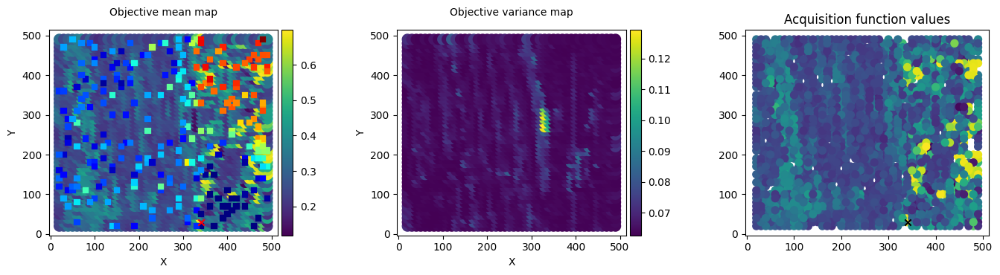

29/100


100%|██████████| 100/100 [00:06<00:00, 16.17it/s, init loss: 60389.5879, avg. loss [96-100]: 57019.7981]



Inferred GP kernel parameters
k_length         [5.2374 4.1022]
k_scale          0.1443
noise            0.06280000000000001


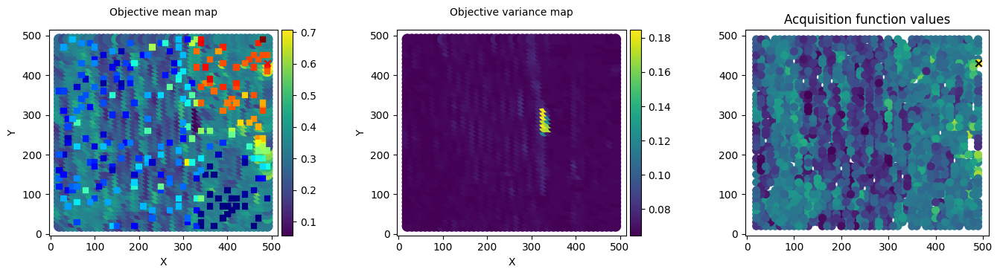

30/100


100%|██████████| 100/100 [00:05<00:00, 18.04it/s, init loss: 60390.7155, avg. loss [96-100]: 57013.4629]



Inferred GP kernel parameters
k_length         [4.1879 4.5096]
k_scale          0.1501
noise            0.0631


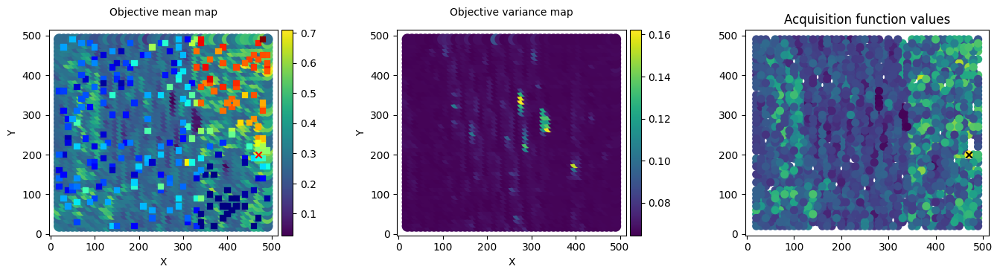

31/100


100%|██████████| 100/100 [00:05<00:00, 17.99it/s, init loss: 60391.8087, avg. loss [96-100]: 56999.0228]



Inferred GP kernel parameters
k_length         [4.6069 3.8546]
k_scale          0.1408
noise            0.0621


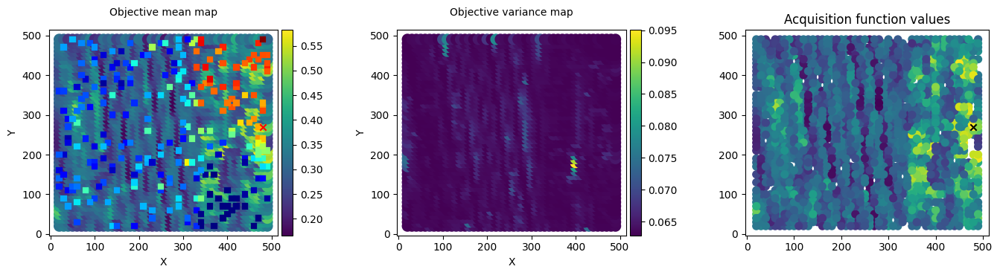

32/100


100%|██████████| 100/100 [00:05<00:00, 17.95it/s, init loss: 60392.9115, avg. loss [96-100]: 57006.0797]



Inferred GP kernel parameters
k_length         [4.1039 4.433 ]
k_scale          0.1365
noise            0.0635


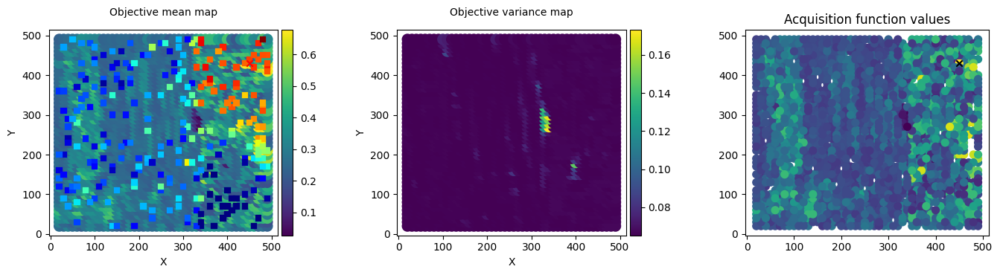

33/100


100%|██████████| 100/100 [00:05<00:00, 17.68it/s, init loss: 60394.1036, avg. loss [96-100]: 57057.7185]



Inferred GP kernel parameters
k_length         [5.0518 5.3821]
k_scale          0.1342
noise            0.061200000000000004


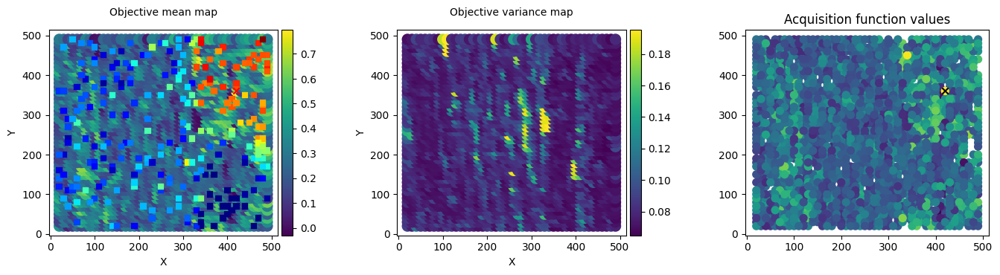

34/100


100%|██████████| 100/100 [00:06<00:00, 15.88it/s, init loss: 60395.4397, avg. loss [96-100]: 56995.0602]



Inferred GP kernel parameters
k_length         [4.4356 4.0592]
k_scale          0.15610000000000002
noise            0.06280000000000001


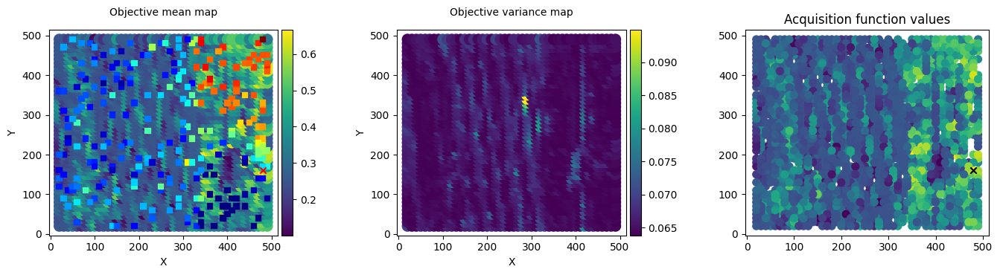

35/100


100%|██████████| 100/100 [00:05<00:00, 17.93it/s, init loss: 60396.5381, avg. loss [96-100]: 57045.4540]



Inferred GP kernel parameters
k_length         [5.797 4.99 ]
k_scale          0.1247
noise            0.062


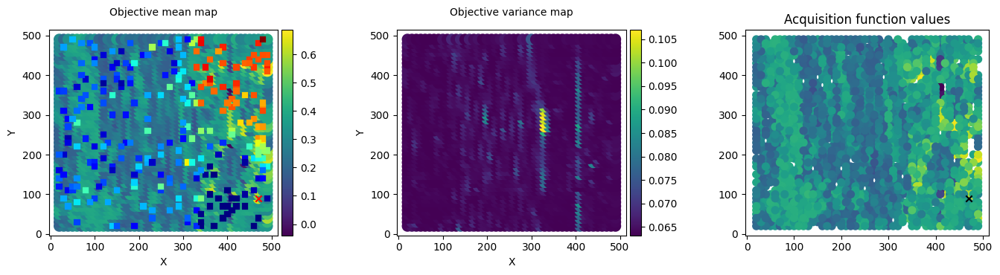

36/100


100%|██████████| 100/100 [00:06<00:00, 16.64it/s, init loss: 60397.6783, avg. loss [96-100]: 56999.5616]



Inferred GP kernel parameters
k_length         [4.8899 3.9759]
k_scale          0.13670000000000002
noise            0.0634


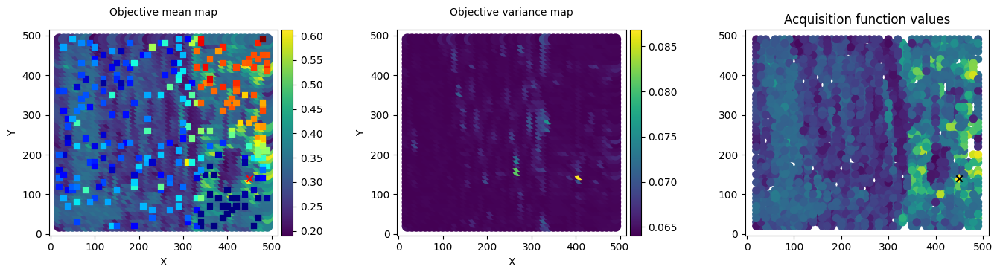

37/100


100%|██████████| 100/100 [00:05<00:00, 18.32it/s, init loss: 60398.7865, avg. loss [96-100]: 57042.2774]



Inferred GP kernel parameters
k_length         [4.8789 4.7121]
k_scale          0.1213
noise            0.0641


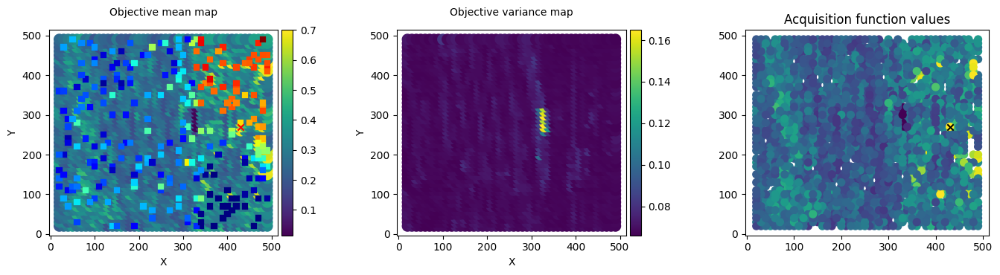

38/100


100%|██████████| 100/100 [00:05<00:00, 17.76it/s, init loss: 60400.0829, avg. loss [96-100]: 57006.3019]



Inferred GP kernel parameters
k_length         [6.3773 3.7528]
k_scale          0.1322
noise            0.0631


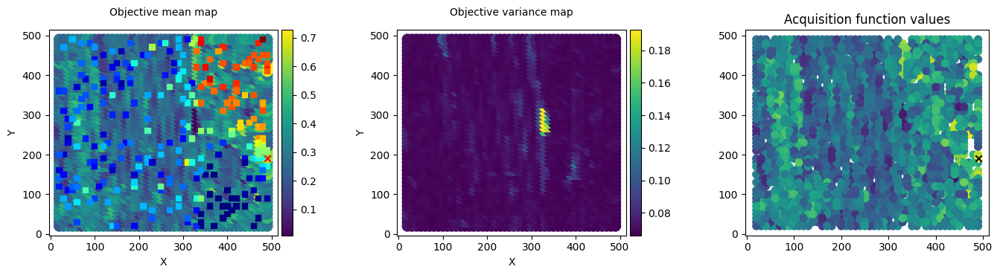

39/100


100%|██████████| 100/100 [00:05<00:00, 17.80it/s, init loss: 60401.2169, avg. loss [96-100]: 57025.9794]



Inferred GP kernel parameters
k_length         [5.7429 4.5309]
k_scale          0.1416
noise            0.0634


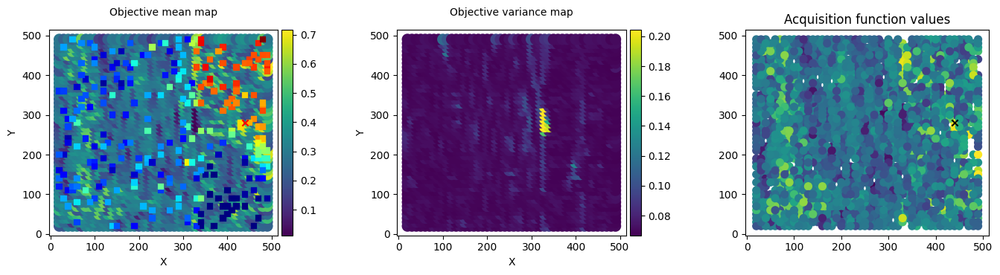

40/100


100%|██████████| 100/100 [00:06<00:00, 16.38it/s, init loss: 60402.3591, avg. loss [96-100]: 57003.5539]



Inferred GP kernel parameters
k_length         [4.5296 4.1684]
k_scale          0.1509
noise            0.0626


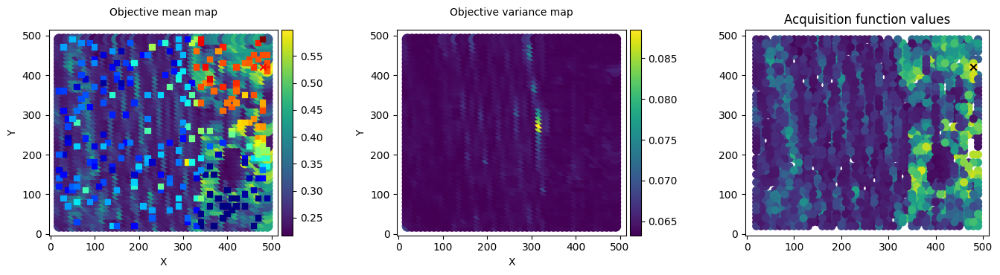

41/100


100%|██████████| 100/100 [00:06<00:00, 15.34it/s, init loss: 60403.5934, avg. loss [96-100]: 57016.9820]



Inferred GP kernel parameters
k_length         [ 9.2186 11.3738]
k_scale          0.0961
noise            0.0645


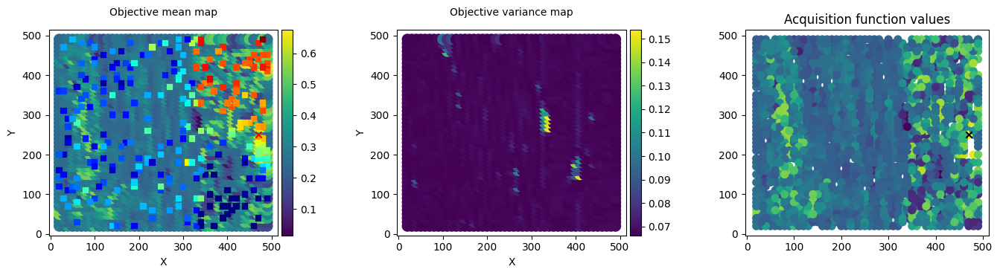

42/100


100%|██████████| 100/100 [00:07<00:00, 13.28it/s, init loss: 60404.6619, avg. loss [96-100]: 57010.4903]



Inferred GP kernel parameters
k_length         [5.6436 5.3876]
k_scale          0.1364
noise            0.06280000000000001


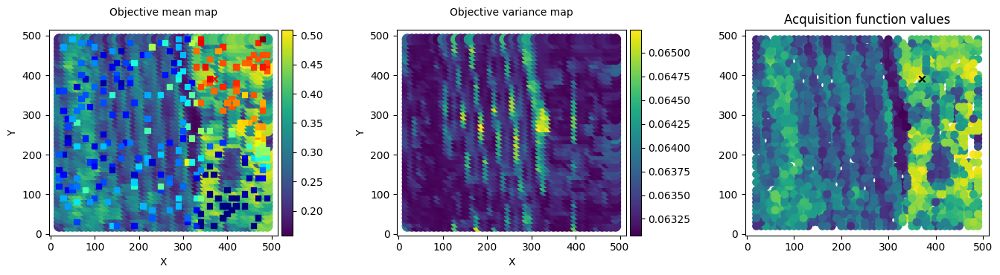

43/100


100%|██████████| 100/100 [00:06<00:00, 15.63it/s, init loss: 60405.7529, avg. loss [96-100]: 57017.4133]



Inferred GP kernel parameters
k_length         [4.9255 6.3885]
k_scale          0.13440000000000002
noise            0.0636


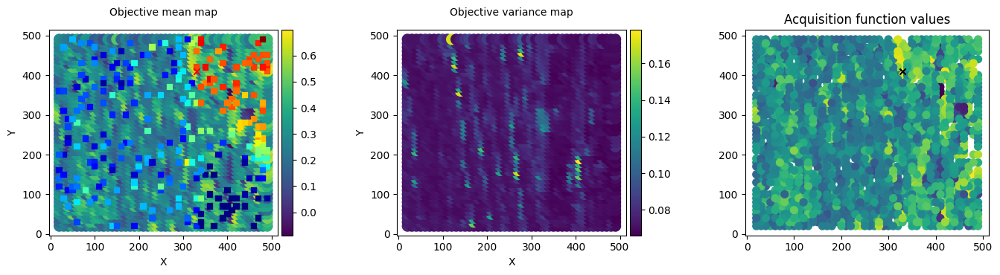

44/100


100%|██████████| 100/100 [00:06<00:00, 15.65it/s, init loss: 60407.0500, avg. loss [96-100]: 57002.7188]



Inferred GP kernel parameters
k_length         [5.048  3.7404]
k_scale          0.1468
noise            0.0611


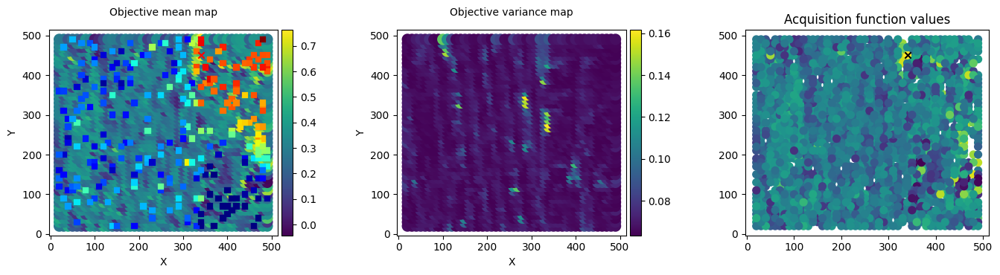

45/100


100%|██████████| 100/100 [00:06<00:00, 15.91it/s, init loss: 60408.1939, avg. loss [96-100]: 57009.5101]



Inferred GP kernel parameters
k_length         [4.7605 4.6474]
k_scale          0.1446
noise            0.062200000000000005


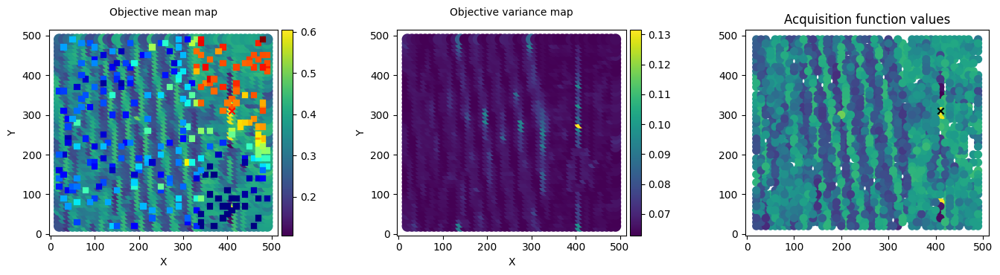

46/100


100%|██████████| 100/100 [00:06<00:00, 15.09it/s, init loss: 60409.4322, avg. loss [96-100]: 57030.2193]



Inferred GP kernel parameters
k_length         [6.1764 6.2669]
k_scale          0.1197
noise            0.0636


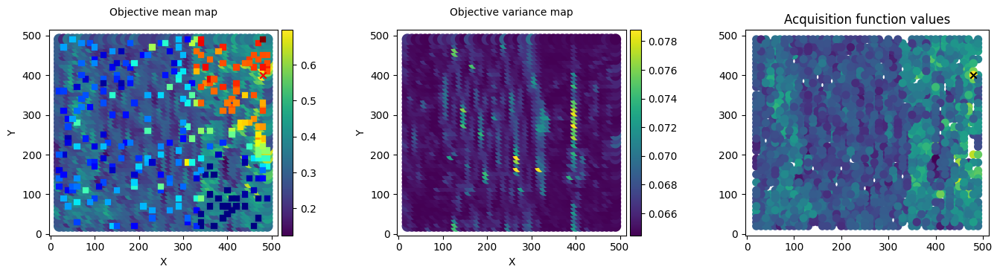

47/100


100%|██████████| 100/100 [00:06<00:00, 15.69it/s, init loss: 60410.5686, avg. loss [96-100]: 57009.3283]



Inferred GP kernel parameters
k_length         [6.1104 4.7683]
k_scale          0.13190000000000002
noise            0.058800000000000005


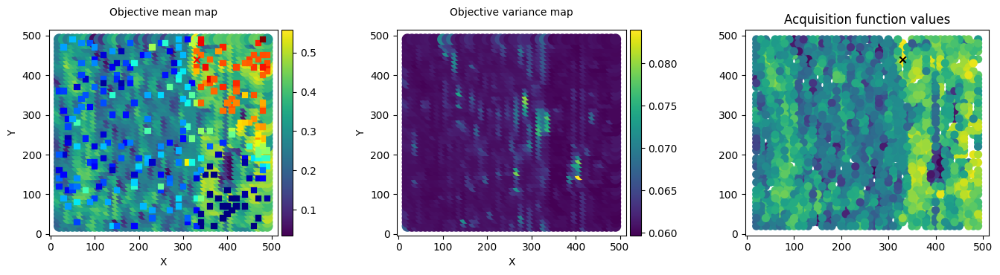

48/100


100%|██████████| 100/100 [00:07<00:00, 13.55it/s, init loss: 60411.7132, avg. loss [96-100]: 57027.8285]



Inferred GP kernel parameters
k_length         [5.9853 4.4657]
k_scale          0.1491
noise            0.0616


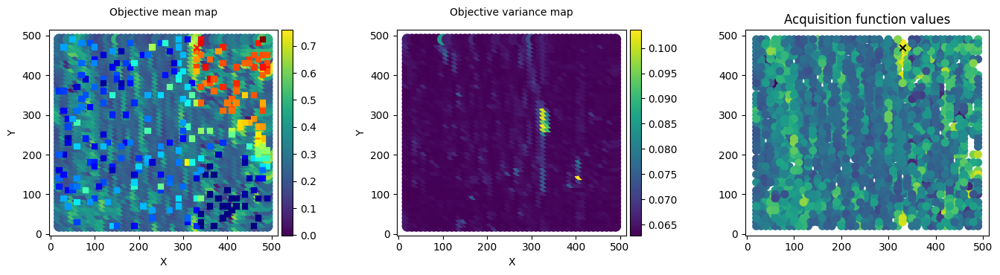

49/100


100%|██████████| 100/100 [00:07<00:00, 13.35it/s, init loss: 60412.8616, avg. loss [96-100]: 57061.4420]



Inferred GP kernel parameters
k_length         [5.1687 4.5513]
k_scale          0.1414
noise            0.0589


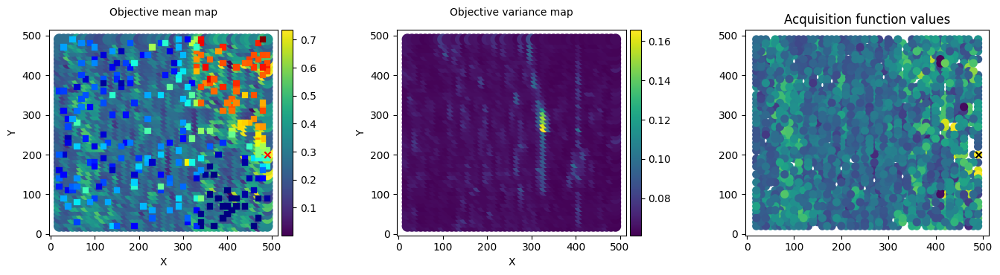

50/100


100%|██████████| 100/100 [00:06<00:00, 15.07it/s, init loss: 60413.9521, avg. loss [96-100]: 57032.6707]



Inferred GP kernel parameters
k_length         [4.8252 4.438 ]
k_scale          0.1366
noise            0.061500000000000006


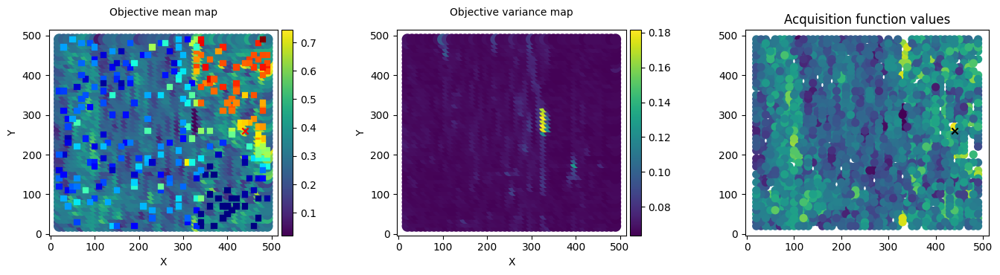

51/100


100%|██████████| 100/100 [00:05<00:00, 16.69it/s, init loss: 60415.0811, avg. loss [96-100]: 57037.5993]



Inferred GP kernel parameters
k_length         [6.0496 5.3845]
k_scale          0.1292
noise            0.059000000000000004


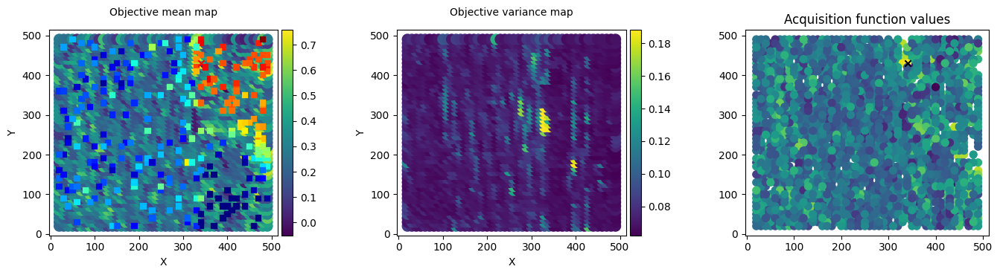

52/100


100%|██████████| 100/100 [00:06<00:00, 15.48it/s, init loss: 60416.2488, avg. loss [96-100]: 57076.6544]



Inferred GP kernel parameters
k_length         [5.5604 5.8758]
k_scale          0.1274
noise            0.0625


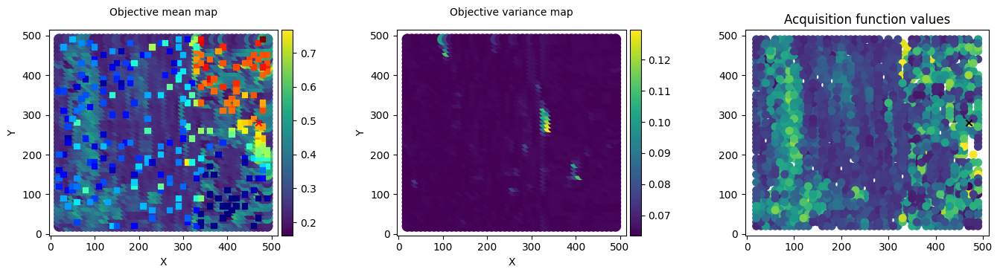

53/100


100%|██████████| 100/100 [00:06<00:00, 15.33it/s, init loss: 60417.3528, avg. loss [96-100]: 57039.5114]



Inferred GP kernel parameters
k_length         [4.6276 5.8014]
k_scale          0.1442
noise            0.060200000000000004


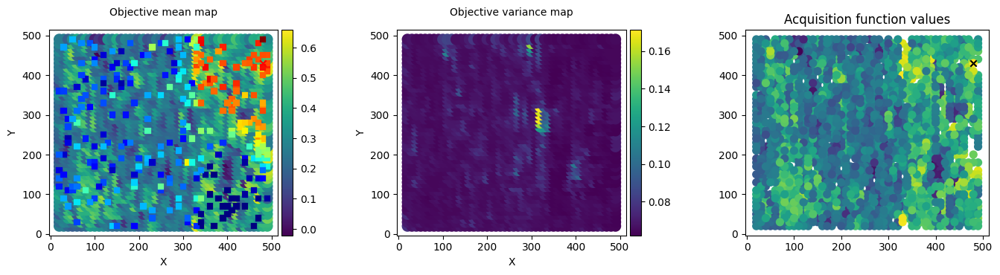

54/100


100%|██████████| 100/100 [00:06<00:00, 14.49it/s, init loss: 60418.5588, avg. loss [96-100]: 57005.1440]



Inferred GP kernel parameters
k_length         [6.4067 5.9947]
k_scale          0.1237
noise            0.06280000000000001


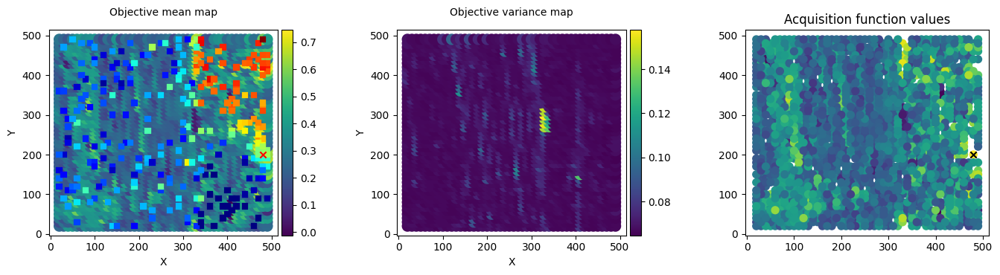

55/100


100%|██████████| 100/100 [00:07<00:00, 13.22it/s, init loss: 60419.7562, avg. loss [96-100]: 57022.8126]



Inferred GP kernel parameters
k_length         [4.2428 5.1629]
k_scale          0.1389
noise            0.0603


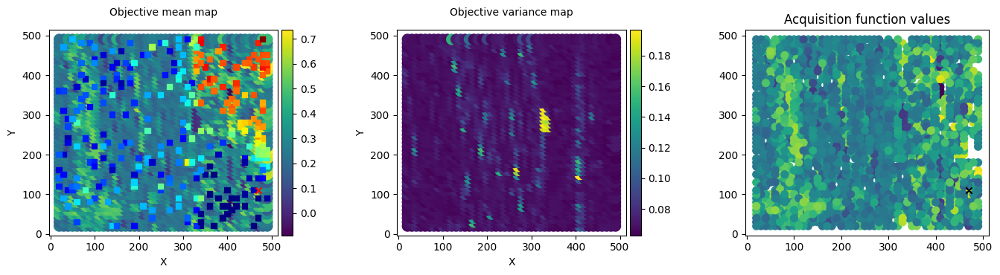

56/100


100%|██████████| 100/100 [00:12<00:00,  8.12it/s, init loss: 60420.8863, avg. loss [96-100]: 57023.6643]



Inferred GP kernel parameters
k_length         [5.4536 5.5569]
k_scale          0.12390000000000001
noise            0.0599


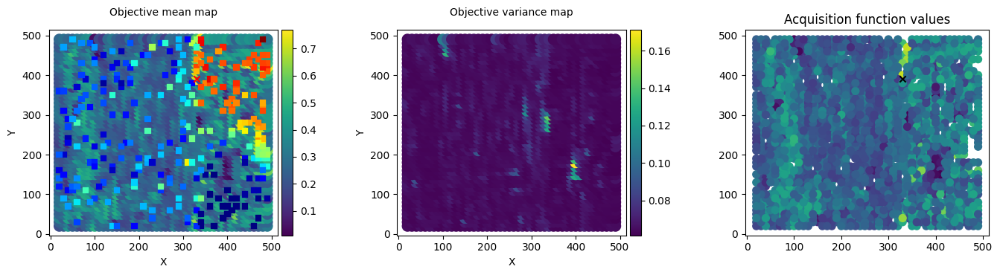

57/100


100%|██████████| 100/100 [00:07<00:00, 12.52it/s, init loss: 60422.0478, avg. loss [96-100]: 57041.8597]



Inferred GP kernel parameters
k_length         [5.9958 6.0961]
k_scale          0.12290000000000001
noise            0.0594


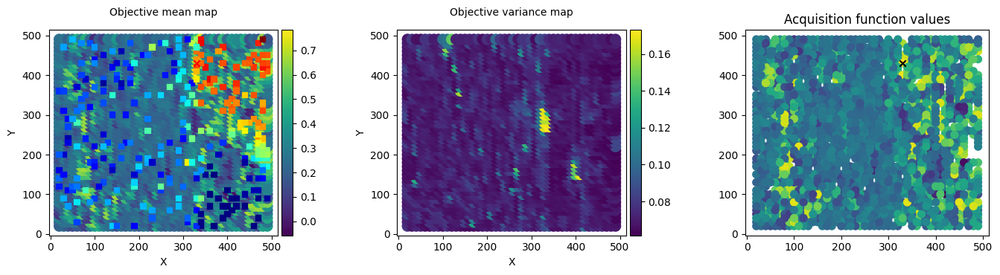

58/100


100%|██████████| 100/100 [00:07<00:00, 13.56it/s, init loss: 60423.2037, avg. loss [96-100]: 57013.9370]



Inferred GP kernel parameters
k_length         [5.3207 5.8166]
k_scale          0.1321
noise            0.061200000000000004


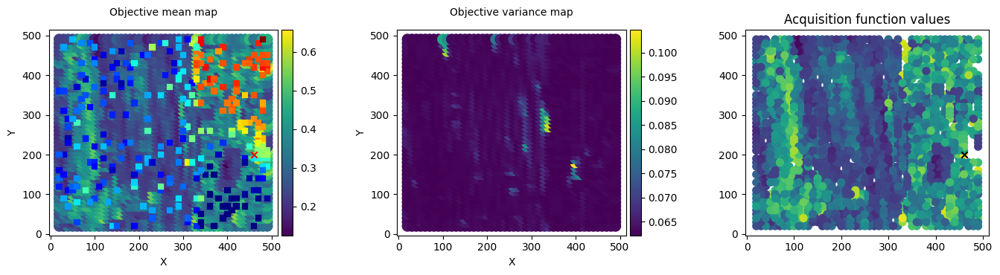

59/100


100%|██████████| 100/100 [00:07<00:00, 13.08it/s, init loss: 60424.2780, avg. loss [96-100]: 57041.7396]



Inferred GP kernel parameters
k_length         [4.7269 5.0261]
k_scale          0.1457
noise            0.062200000000000005


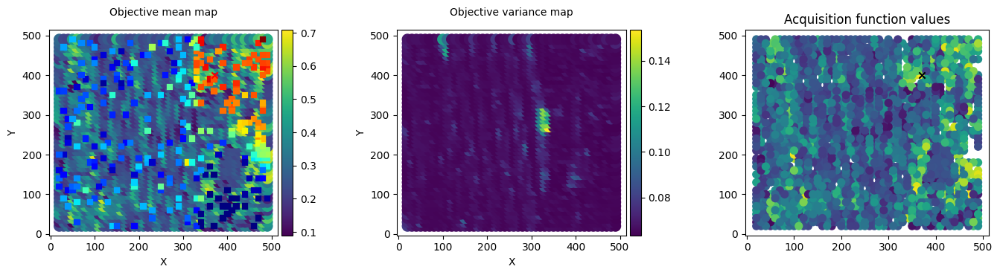

60/100


100%|██████████| 100/100 [00:08<00:00, 11.54it/s, init loss: 60425.3991, avg. loss [96-100]: 57019.3520]



Inferred GP kernel parameters
k_length         [6.0668 5.0188]
k_scale          0.1401
noise            0.0596


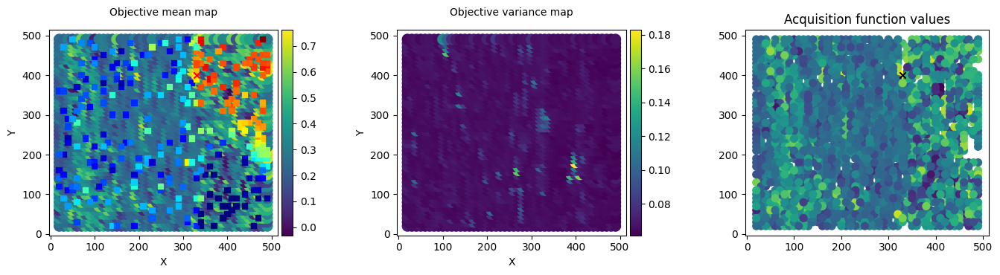

61/100


100%|██████████| 100/100 [00:08<00:00, 12.23it/s, init loss: 60426.5351, avg. loss [96-100]: 57033.3038]



Inferred GP kernel parameters
k_length         [5.9995 5.9206]
k_scale          0.1277
noise            0.058800000000000005


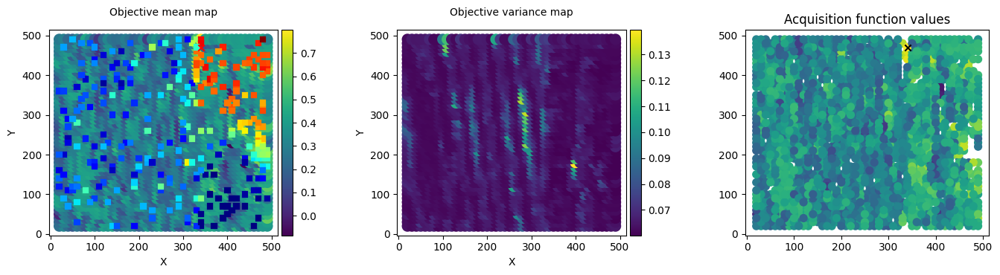

62/100


100%|██████████| 100/100 [00:07<00:00, 12.67it/s, init loss: 60427.8284, avg. loss [96-100]: 57015.2439]



Inferred GP kernel parameters
k_length         [4.4729 5.4516]
k_scale          0.1418
noise            0.0591


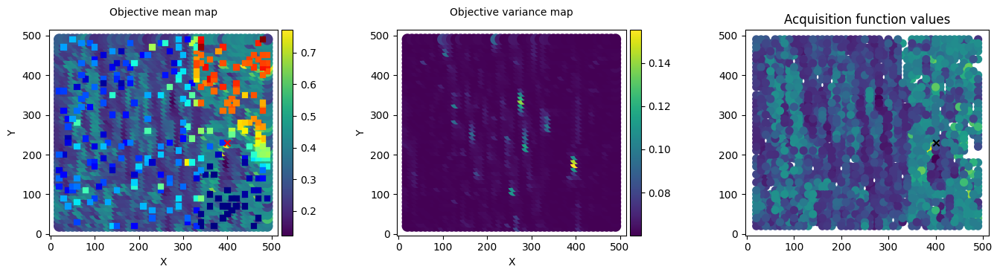

63/100


100%|██████████| 100/100 [00:07<00:00, 13.19it/s, init loss: 60428.9310, avg. loss [96-100]: 57029.2617]



Inferred GP kernel parameters
k_length         [7.6926 6.9406]
k_scale          0.11720000000000001
noise            0.0614


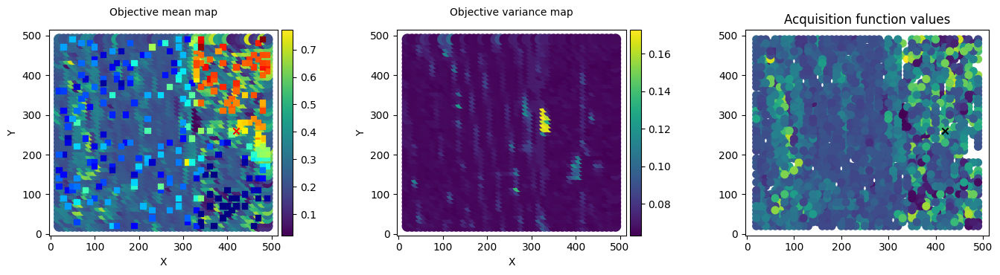

64/100


100%|██████████| 100/100 [00:08<00:00, 12.17it/s, init loss: 60430.1717, avg. loss [96-100]: 57015.7188]



Inferred GP kernel parameters
k_length         [4.2615 4.0175]
k_scale          0.1327
noise            0.056400000000000006


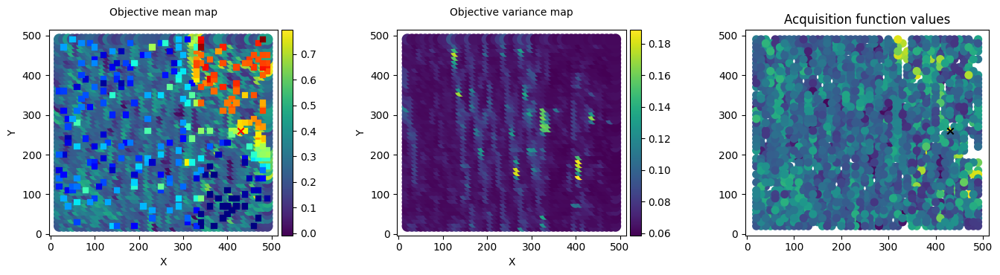

65/100


100%|██████████| 100/100 [00:08<00:00, 11.87it/s, init loss: 60431.2945, avg. loss [96-100]: 57028.8398]



Inferred GP kernel parameters
k_length         [6.3625 4.7245]
k_scale          0.1264
noise            0.0635


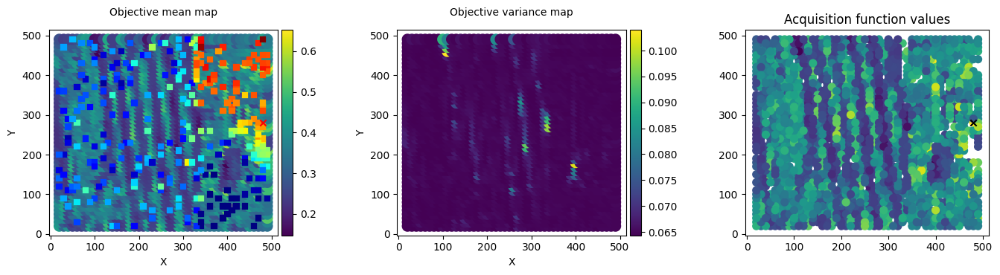

66/100


100%|██████████| 100/100 [00:08<00:00, 11.65it/s, init loss: 60432.3980, avg. loss [96-100]: 57036.5789]



Inferred GP kernel parameters
k_length         [4.8811 5.042 ]
k_scale          0.1325
noise            0.061700000000000005


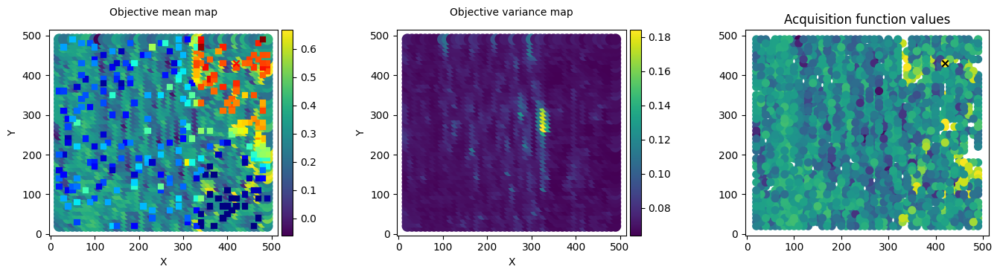

67/100


100%|██████████| 100/100 [00:07<00:00, 12.77it/s, init loss: 60433.6319, avg. loss [96-100]: 57070.5703]



Inferred GP kernel parameters
k_length         [5.3361 6.3491]
k_scale          0.1355
noise            0.0594


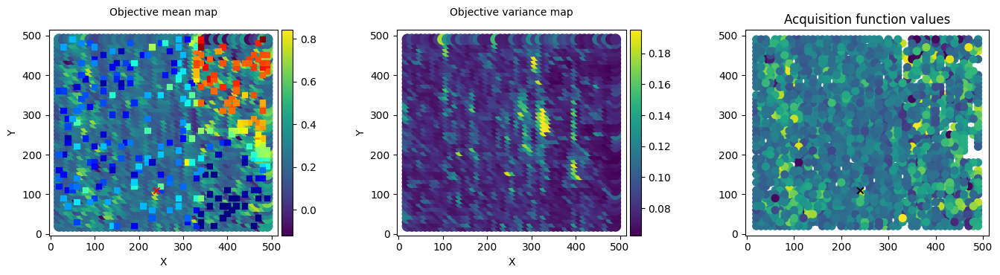

68/100


100%|██████████| 100/100 [00:07<00:00, 12.92it/s, init loss: 60434.7629, avg. loss [96-100]: 57014.4793]



Inferred GP kernel parameters
k_length         [6.7192 6.5349]
k_scale          0.1431
noise            0.0611


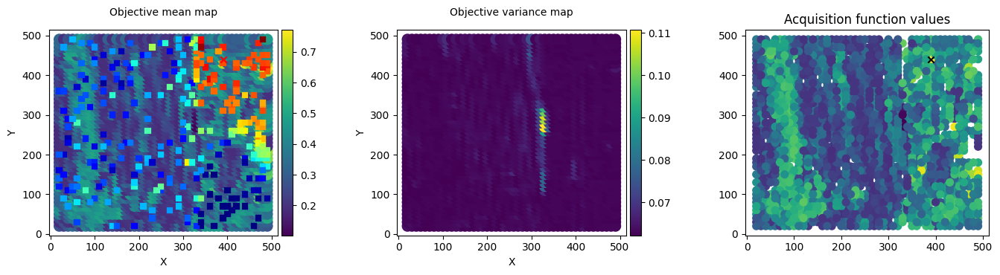

69/100


100%|██████████| 100/100 [00:08<00:00, 11.64it/s, init loss: 60435.8533, avg. loss [96-100]: 57015.8307]



Inferred GP kernel parameters
k_length         [7.2056 6.2129]
k_scale          0.1293
noise            0.0616


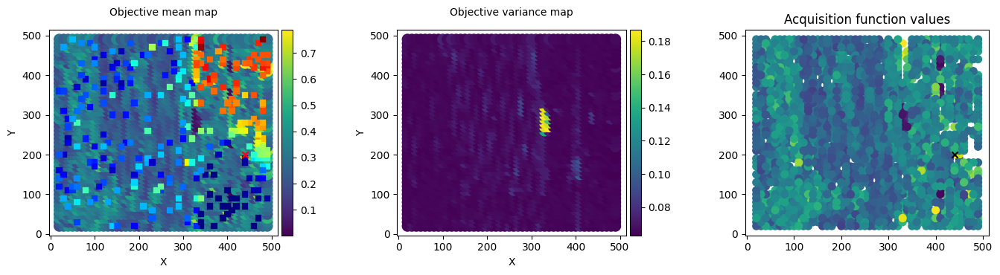

70/100


100%|██████████| 100/100 [00:08<00:00, 11.42it/s, init loss: 60436.9449, avg. loss [96-100]: 57006.9805]



Inferred GP kernel parameters
k_length         [6.7496 6.0011]
k_scale          0.1158
noise            0.060200000000000004


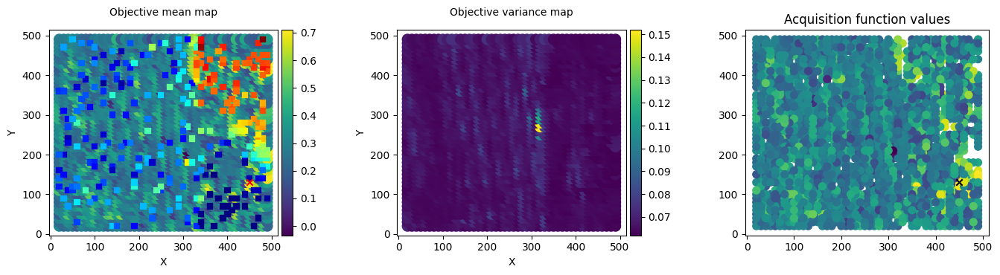

71/100


100%|██████████| 100/100 [00:13<00:00,  7.37it/s, init loss: 60438.1320, avg. loss [96-100]: 57020.8440]



Inferred GP kernel parameters
k_length         [8.169  6.3407]
k_scale          0.12890000000000001
noise            0.060700000000000004


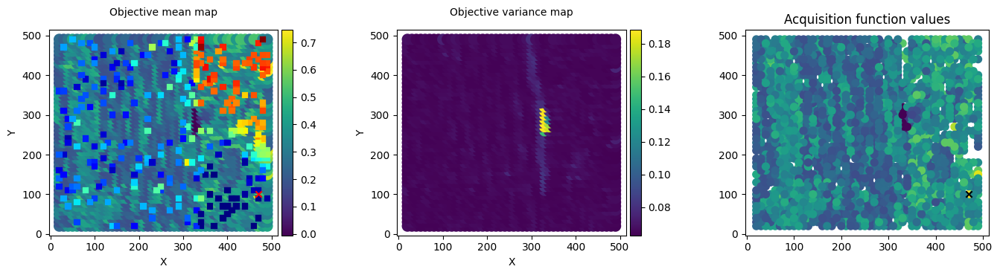

72/100


100%|██████████| 100/100 [00:08<00:00, 12.32it/s, init loss: 60439.3141, avg. loss [96-100]: 57061.2424]



Inferred GP kernel parameters
k_length         [6.3743 6.2303]
k_scale          0.12090000000000001
noise            0.0631


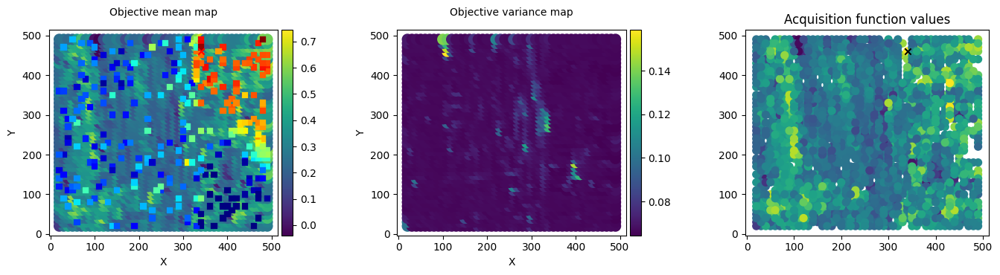

73/100


100%|██████████| 100/100 [00:08<00:00, 11.90it/s, init loss: 60440.4824, avg. loss [96-100]: 57027.3345]



Inferred GP kernel parameters
k_length         [6.7486 6.7743]
k_scale          0.1267
noise            0.061900000000000004


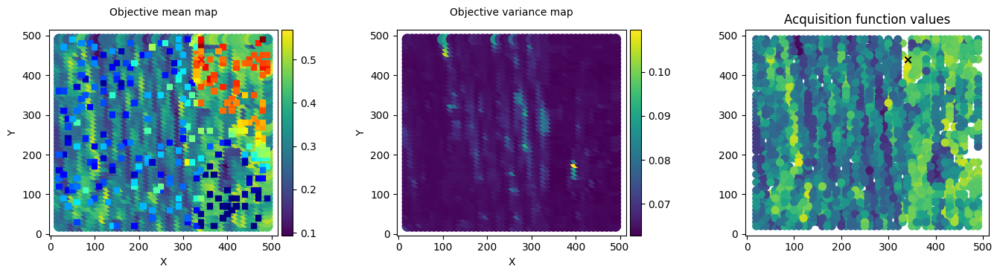

74/100


100%|██████████| 100/100 [00:08<00:00, 11.68it/s, init loss: 60441.6252, avg. loss [96-100]: 57031.6501]



Inferred GP kernel parameters
k_length         [6.6445 6.0856]
k_scale          0.1358
noise            0.0611


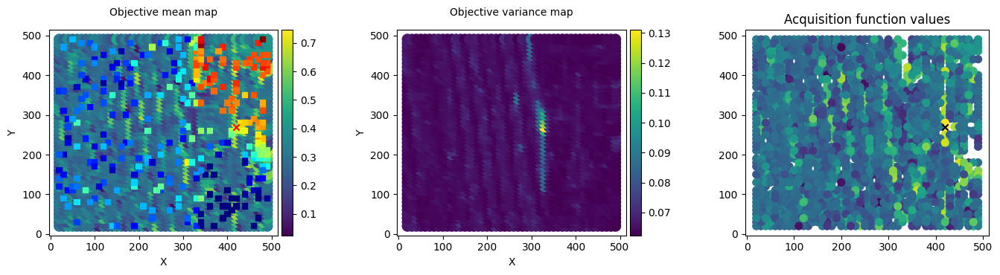

75/100


100%|██████████| 100/100 [00:07<00:00, 12.98it/s, init loss: 60442.8225, avg. loss [96-100]: 57018.2374]



Inferred GP kernel parameters
k_length         [5.5453 5.0722]
k_scale          0.1424
noise            0.063


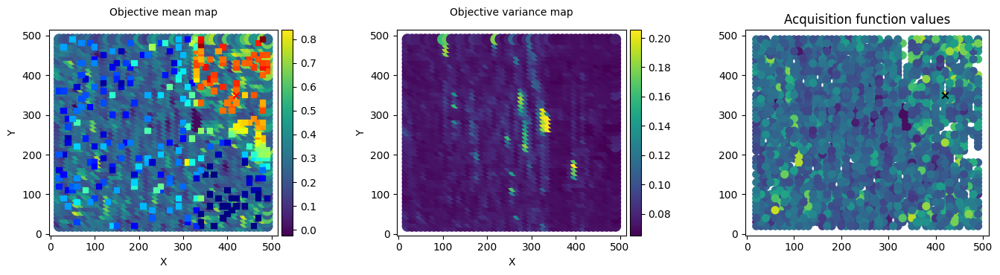

76/100


100%|██████████| 100/100 [00:07<00:00, 12.59it/s, init loss: 60444.0158, avg. loss [96-100]: 57038.3946]



Inferred GP kernel parameters
k_length         [7.1834 5.9594]
k_scale          0.1211
noise            0.059500000000000004


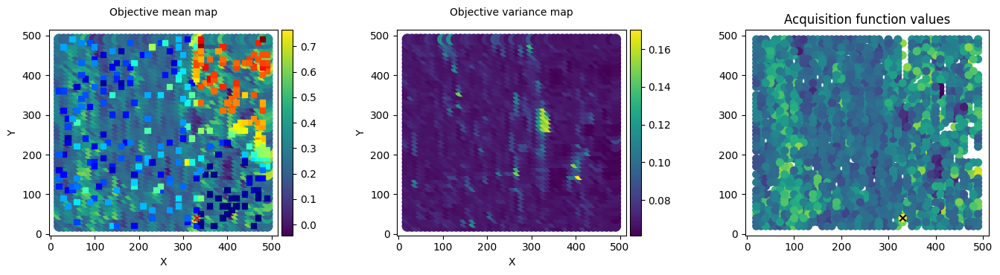

77/100


100%|██████████| 100/100 [00:08<00:00, 11.63it/s, init loss: 60445.2057, avg. loss [96-100]: 57083.8574]



Inferred GP kernel parameters
k_length         [7.7044 8.1786]
k_scale          0.1134
noise            0.062200000000000005


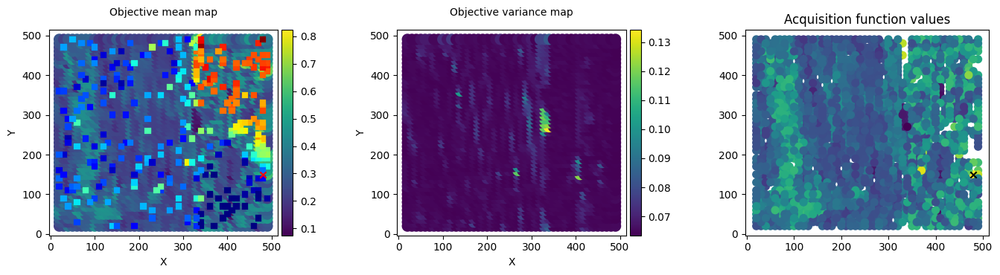

78/100


100%|██████████| 100/100 [00:08<00:00, 11.13it/s, init loss: 60446.3755, avg. loss [96-100]: 57031.2048]



Inferred GP kernel parameters
k_length         [6.743  6.5099]
k_scale          0.1216
noise            0.0631


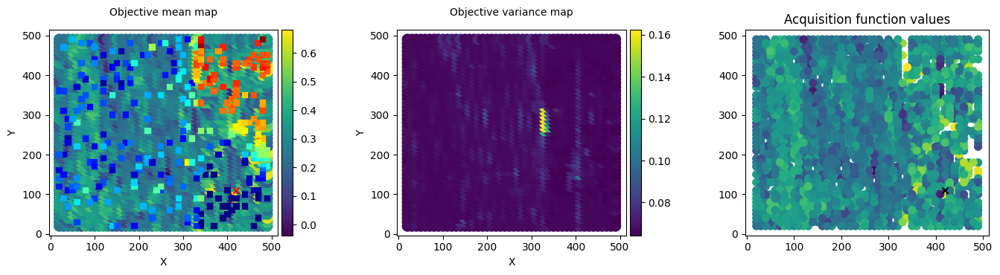

79/100


100%|██████████| 100/100 [00:07<00:00, 12.68it/s, init loss: 60447.5795, avg. loss [96-100]: 57017.1116]



Inferred GP kernel parameters
k_length         [6.9004 6.1671]
k_scale          0.1212
noise            0.0572


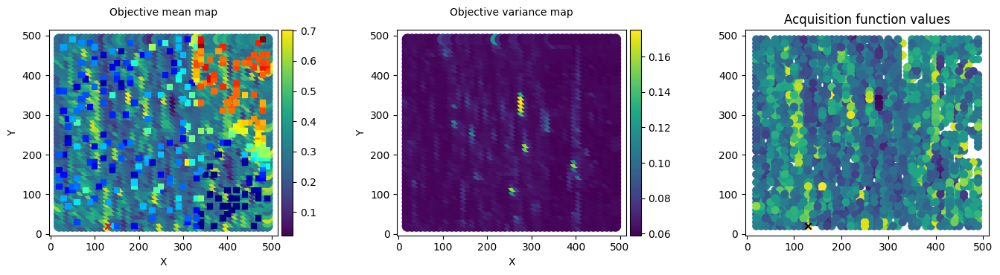

80/100


100%|██████████| 100/100 [00:07<00:00, 12.53it/s, init loss: 60448.8821, avg. loss [96-100]: 57017.1742]



Inferred GP kernel parameters
k_length         [5.6289 4.6105]
k_scale          0.1358
noise            0.0629


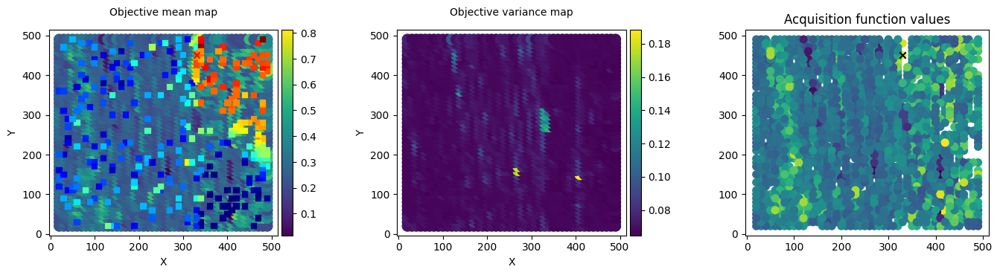

81/100


100%|██████████| 100/100 [00:08<00:00, 11.25it/s, init loss: 60450.0405, avg. loss [96-100]: 57027.1235]



Inferred GP kernel parameters
k_length         [7.1997 5.5321]
k_scale          0.12710000000000002
noise            0.061500000000000006


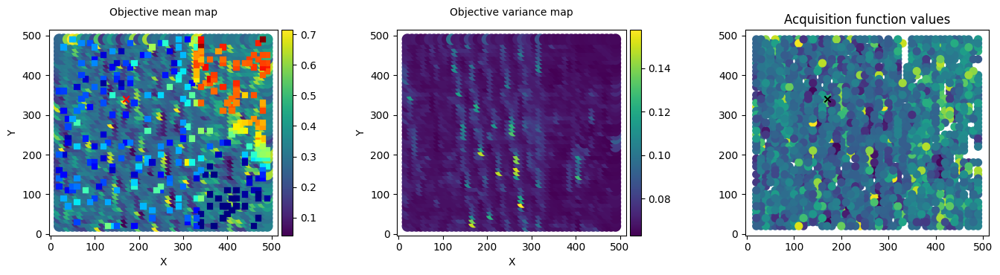

82/100


100%|██████████| 100/100 [00:08<00:00, 11.14it/s, init loss: 60451.2213, avg. loss [96-100]: 57034.5038]



Inferred GP kernel parameters
k_length         [6.4196 6.2891]
k_scale          0.12440000000000001
noise            0.0584


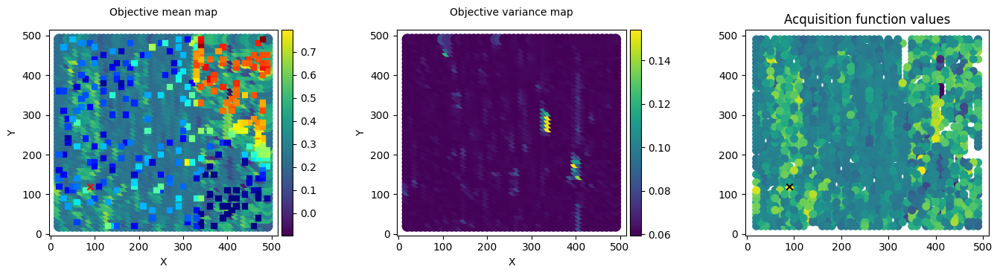

83/100


100%|██████████| 100/100 [00:07<00:00, 12.69it/s, init loss: 60452.3253, avg. loss [96-100]: 57001.6754]



Inferred GP kernel parameters
k_length         [5.8741 6.1055]
k_scale          0.1301
noise            0.059000000000000004


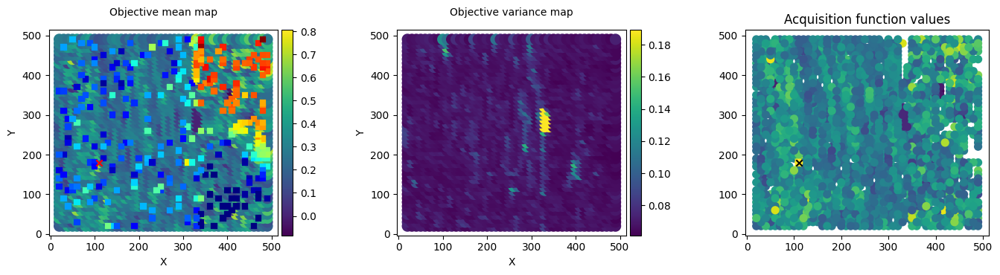

84/100


100%|██████████| 100/100 [00:07<00:00, 12.70it/s, init loss: 60453.4583, avg. loss [96-100]: 57045.3327]



Inferred GP kernel parameters
k_length         [6.9839 6.4315]
k_scale          0.1192
noise            0.0632


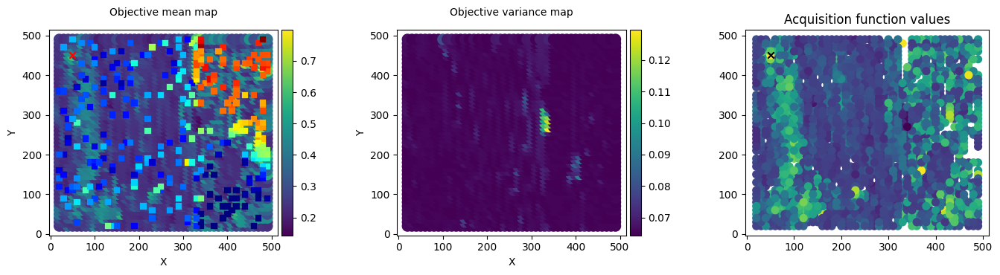

85/100


100%|██████████| 100/100 [00:08<00:00, 12.45it/s, init loss: 60454.5348, avg. loss [96-100]: 57027.5688]



Inferred GP kernel parameters
k_length         [6.4858 5.997 ]
k_scale          0.1285
noise            0.0632


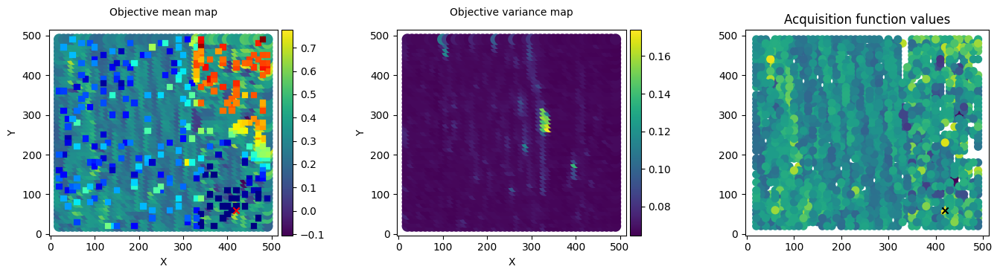

86/100


100%|██████████| 100/100 [00:13<00:00,  7.15it/s, init loss: 60455.7715, avg. loss [96-100]: 57019.5981]



Inferred GP kernel parameters
k_length         [5.5329 5.223 ]
k_scale          0.1346
noise            0.058300000000000005


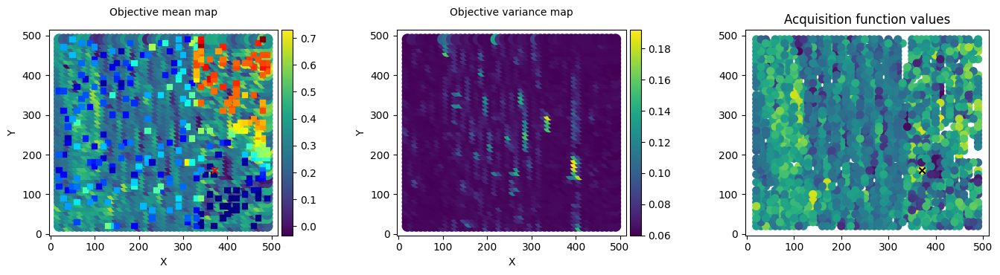

87/100


100%|██████████| 100/100 [00:08<00:00, 12.04it/s, init loss: 60456.9234, avg. loss [96-100]: 57055.8144]



Inferred GP kernel parameters
k_length         [7.9033 6.9197]
k_scale          0.11910000000000001
noise            0.064


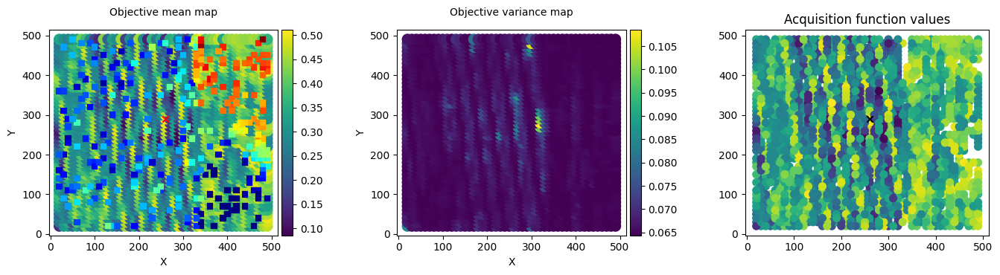

88/100


100%|██████████| 100/100 [00:09<00:00, 10.54it/s, init loss: 60458.1708, avg. loss [96-100]: 57037.4119]



Inferred GP kernel parameters
k_length         [5.8261 5.7232]
k_scale          0.1213
noise            0.0621


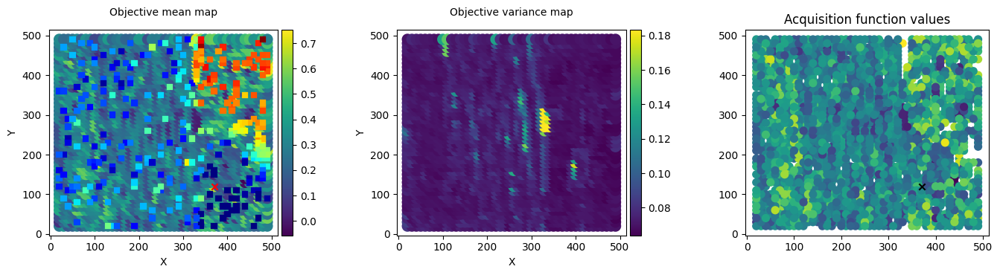

89/100


100%|██████████| 100/100 [00:08<00:00, 11.72it/s, init loss: 60459.2865, avg. loss [96-100]: 57023.2564]



Inferred GP kernel parameters
k_length         [5.2787 5.8991]
k_scale          0.1408
noise            0.061900000000000004


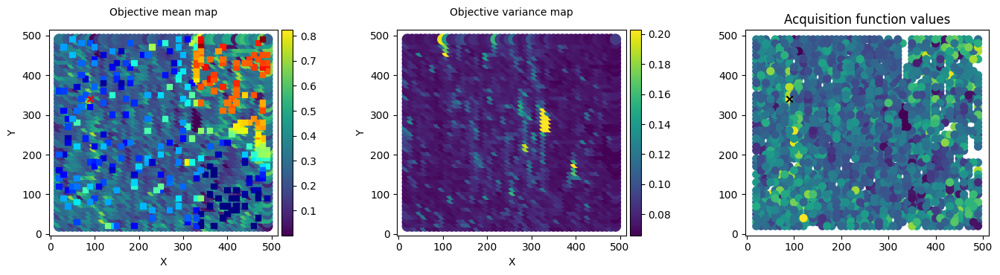

90/100


100%|██████████| 100/100 [00:08<00:00, 11.68it/s, init loss: 60460.4301, avg. loss [96-100]: 57052.7101]



Inferred GP kernel parameters
k_length         [6.5592 6.3071]
k_scale          0.12050000000000001
noise            0.0621


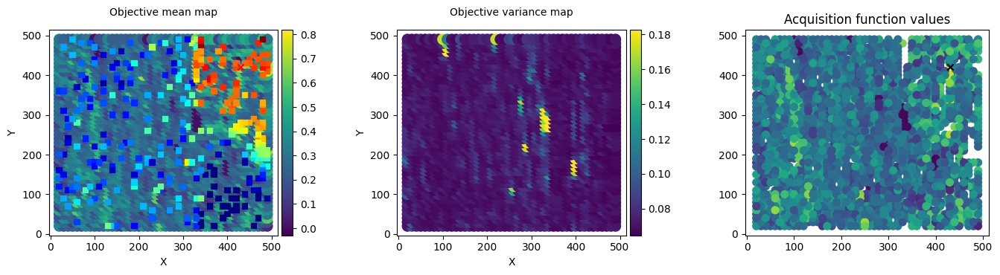

91/100


100%|██████████| 100/100 [00:08<00:00, 11.69it/s, init loss: 60461.6087, avg. loss [96-100]: 57083.0667]



Inferred GP kernel parameters
k_length         [5.5509 5.8173]
k_scale          0.1227
noise            0.0625


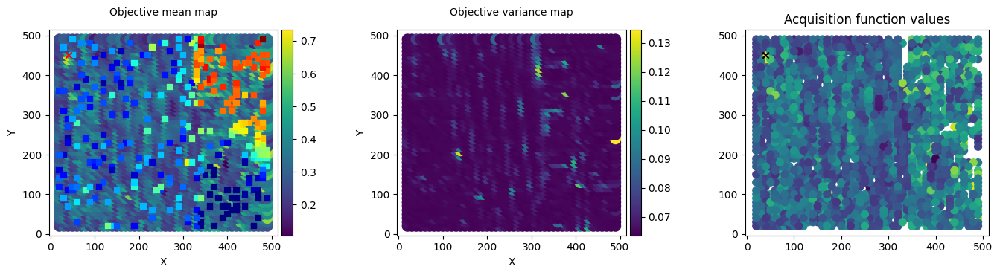

92/100


100%|██████████| 100/100 [00:09<00:00, 11.05it/s, init loss: 60462.7462, avg. loss [96-100]: 57045.0733]



Inferred GP kernel parameters
k_length         [6.7816 5.3191]
k_scale          0.1263
noise            0.06470000000000001


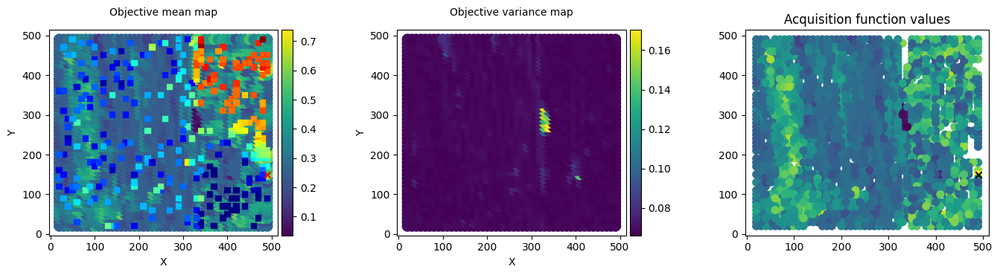

93/100


100%|██████████| 100/100 [00:09<00:00, 10.62it/s, init loss: 60463.8709, avg. loss [96-100]: 57048.9380]



Inferred GP kernel parameters
k_length         [8.4901 6.7197]
k_scale          0.1106
noise            0.061900000000000004


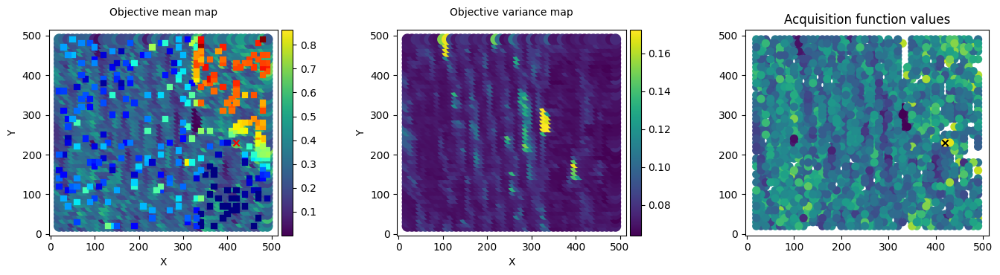

94/100


100%|██████████| 100/100 [00:08<00:00, 11.91it/s, init loss: 60464.9923, avg. loss [96-100]: 57047.1361]



Inferred GP kernel parameters
k_length         [6.1693 5.7638]
k_scale          0.1208
noise            0.058300000000000005


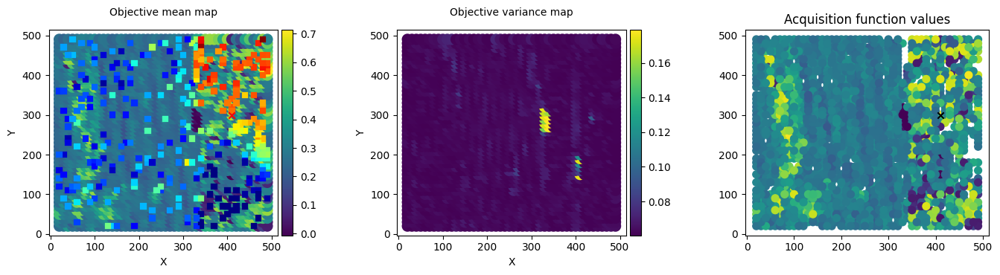

95/100


100%|██████████| 100/100 [00:09<00:00, 10.58it/s, init loss: 60466.2130, avg. loss [96-100]: 57032.5609]



Inferred GP kernel parameters
k_length         [6.596  5.1575]
k_scale          0.1318
noise            0.0653


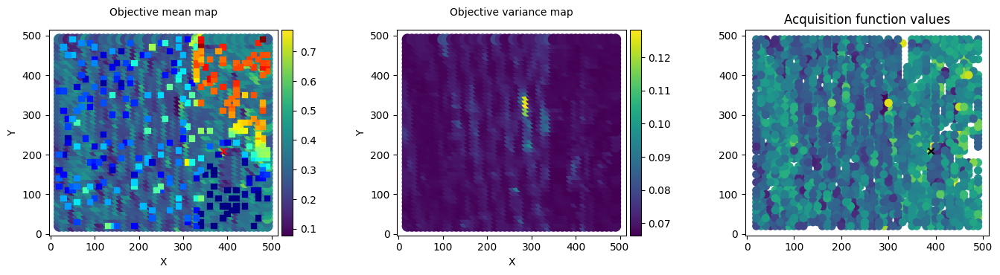

96/100


100%|██████████| 100/100 [00:14<00:00,  7.06it/s, init loss: 60467.3588, avg. loss [96-100]: 57027.7590]



Inferred GP kernel parameters
k_length         [6.2352 4.8529]
k_scale          0.1448
noise            0.06330000000000001


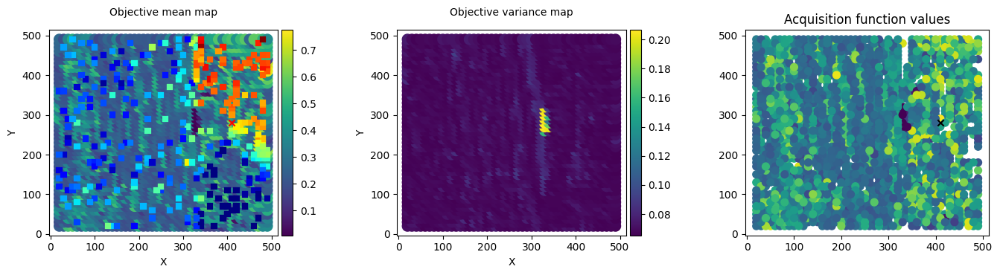

97/100


100%|██████████| 100/100 [00:08<00:00, 11.83it/s, init loss: 60468.5136, avg. loss [96-100]: 57071.0972]



Inferred GP kernel parameters
k_length         [6.1014 7.2202]
k_scale          0.1255
noise            0.062400000000000004


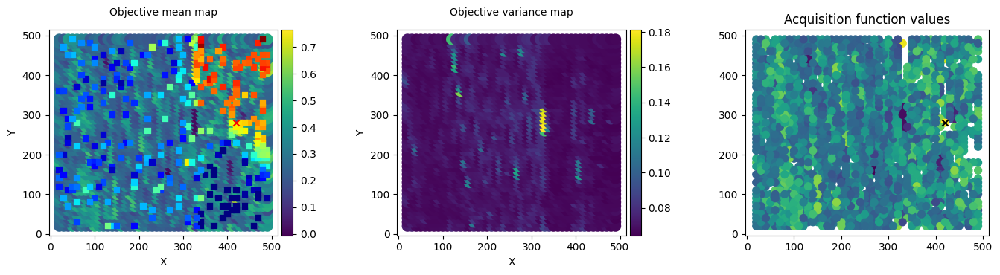

98/100


100%|██████████| 100/100 [00:08<00:00, 11.33it/s, init loss: 60469.6361, avg. loss [96-100]: 57045.1194]



Inferred GP kernel parameters
k_length         [5.0556 6.4718]
k_scale          0.1277
noise            0.0606


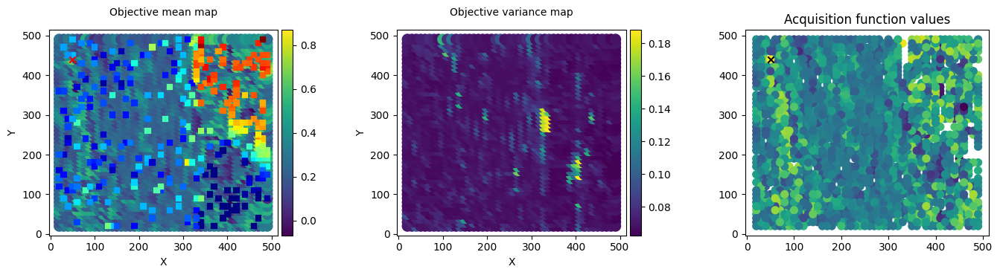

99/100


100%|██████████| 100/100 [00:08<00:00, 11.57it/s, init loss: 60470.7255, avg. loss [96-100]: 57020.0680]



Inferred GP kernel parameters
k_length         [5.3742 6.1074]
k_scale          0.1301
noise            0.0621


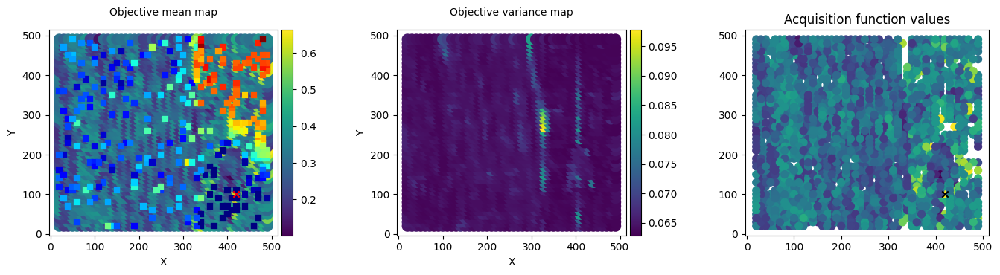

100/100


100%|██████████| 100/100 [00:08<00:00, 11.57it/s, init loss: 60471.8605, avg. loss [96-100]: 57025.3748]



Inferred GP kernel parameters
k_length         [5.7175 6.0445]
k_scale          0.1389
noise            0.0656


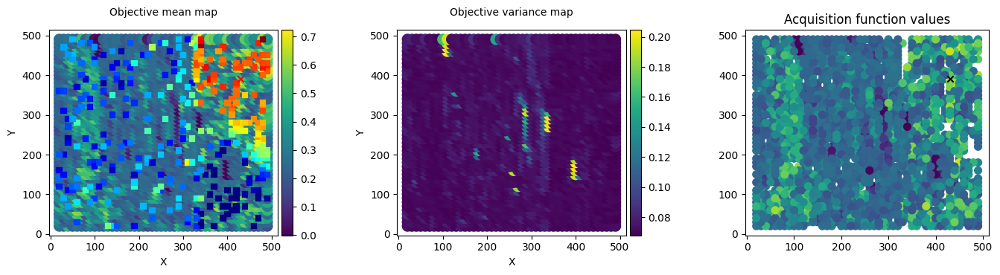

In [282]:
# DKL Implementation - Active learning

exploration_steps = 100


for e in range(exploration_steps):

    print("{}/{}".format(e+1, exploration_steps))

    key1, key2 = gpax.utils.get_keys()
    data_dim = X_train.shape[-1]

    #Normalize train output
    y_train_norm = normalize_0to1(y_train)

    #Train model
    dkl = gpax.viDKL(data_dim, 2, kernel = 'RBF')

    dkl.fit(key1, X_train, y_train_norm, num_steps=100, step_size=0.05)

    # Compute UCB acquisition function with beta annealed in range 10 - 0.001

    power_f = (len(y_train) - initial_train)
    if power_f < 1:
        power_f = 0

    beta_iter = 10 * (0.9**(power_f))

    if beta_iter < 0.001:
        beta_iter = 0.001

    obj = gpax.acquisition.UCB(key2, dkl, X_test, beta=beta_iter, maximize=True)   # you may decrease step size and increase number of steps (e.g. to 0.005 and 1000) for more stable performance

    # DKL prediction
    mean, var = dkl.predict(key2, X)

    # Select next point to "measure"
    next_point_idx = obj.argmax()
    next_point = indices_test[next_point_idx]   # coordinate of the points

    # Do "measurement" - based on ground truth data
    measured_point = y_test[next_point_idx]

    # Plot current result
    plot_DKL_prediction(mean, var, obj, indices_test, indices_train, y_train)

    # Update train and test sets

    X_train = np.append(X_train, np.asarray([X_test[next_point_idx]]), axis = 0)
    X_test = np.delete(X_test, next_point_idx, 0)

    y_train = np.append(y_train, measured_point)
    y_test = np.delete(y_test, next_point_idx)

    indices_train = np.append(indices_train, np.asarray([next_point]), 0)
    indices_test = np.delete(indices_test, next_point_idx, 0)

# Analyze DKL prediction

DKL prediction

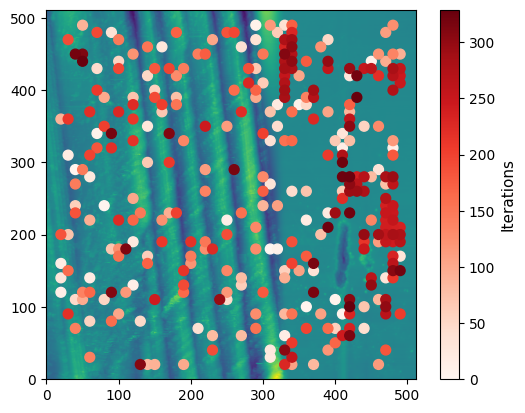

In [283]:
plt.imshow(ds_image, origin = 'lower')
plt.scatter(indices_train[:, 1], indices_train[:, 0], c=np.arange(len(indices_train[:])), s=50, cmap="Reds")
cbar = plt.colorbar()
cbar.set_label(r"Iterations", size = 11)
plt.show()


DKL scalar map

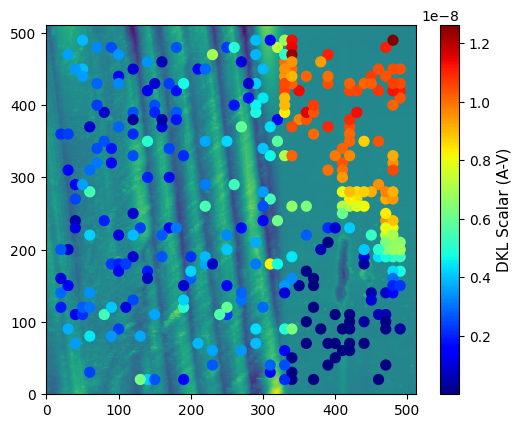

In [284]:
plt.imshow(ds_image, origin = 'lower')
plt.scatter(indices_train[:, 1], indices_train[:, 0], c=y_train, s=50, cmap="jet")
cbar = plt.colorbar()
cbar.set_label(r"DKL Scalar (A-V)", size = 11)
plt.show()